In [1]:
import xarray as xr
import dask
import numpy as np
from datetime import datetime, timedelta
from cartopy.feature.nightshade import Nightshade
import cartopy.crs as ccrs
import matplotlib.pyplot as plt
import os, glob, sys, gc
from tqdm.auto import tqdm
import pandas as pd

/glade/work/abukowski/conda-envs/SAMI3-GITM/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
import argparse
import glob
import os
from datetime import timedelta

import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import matplotlib.colors as colors
from mpl_toolkits.axes_grid1 import make_axes_locatable

import numpy as np
import xarray as xr

import importlib

import warnings

In [3]:
import utility_programs.filters as filters
from utility_programs.plotting_routines import panel_plot
from utility_programs.read_routines.GITM import auto_read as auto_read_gitm
from utility_programs.read_routines.GITM import gitm_times_from_filelist
from utility_programs.read_routines.SAMI import auto_read as auto_read_sami
from utility_programs import plotting_routines
from utility_programs.utils import ut_to_lt
from utility_programs.utils import add_lt_to_dataset
from  utility_programs import utils 

/glade/u/home/abukowski/Documents/CEDAR2023/utility_programs/plotting_routines.py:13: FutureWarning: The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.
  world = geopandas.read_file(geopandas.datasets.get_path("naturalearth_lowres"))


In [4]:
data = '/glade/u/home/abukowski/scratch/postprocessed/'

In [5]:
gitms = {}
samis = {}

for full_path in np.sort(glob.glob(os.path.join(data,'*.nc'))):

    fname = full_path[full_path.rfind('/')+1:]
    datas = fname[:-3].split('_')
    month = datas[0]

    if 'bz' in datas[1]:
        if 'SAMI' in datas:
            model = datas[-2] + '-'+datas[-1]
        else:
            model = datas[-1]
        month = datas[0]
        runname = datas[1][5:]
        onset = datas[2]
        duration = datas[3]

    elif 'thm' not in datas:
        if 'SAMI' in datas:
            model = datas[-2] + '-'+datas[-1]
        else:
            model = datas[-1]
        month = datas[0]
        runname = datas[1]
        onset = datas[2]
        duration = datas[3]
        
    else:
        continue

    if model == 'GITM':
        gitms['-'.join([month, onset, duration, runname])] = xr.open_mfdataset(full_path, engine='h5netcdf')

    elif model == 'SAMI-REGRID':
        samis['-'.join([month, onset, duration, runname])] = xr.open_mfdataset(full_path, engine='h5netcdf')


In [6]:
# Preprocess


## Time slicing
t_starts = {'ut6':'03:00:00', 'ut12':'09:00:00', 'ut18':'15:00:00'}

for k in gitms.keys():
    key = k.split('-')[1]
    t_start = gitms[k].time.values[0] + pd.Timedelta('1 day' + t_starts[key])
    t_end = t_start + pd.Timedelta('10 hours')
    
    gitms[k] = gitms[k].sel(time = slice(t_start, t_end))
    
for k in samis.keys():
    key = k.split('-')[1]
    t_start = samis[k].time.values[0] + pd.Timedelta('1 day' + t_starts[key])
    t_end = t_start + pd.Timedelta('8 hours')
    samis[k] = samis[k].sel(time = slice(t_start, t_end))    


In [7]:
def format_colname_for_title(runname, unpack_bz=False):
    
    names = runname.split('-')
    outname = ' '.join([i[0].upper()+i[1:] for i in runname.split('-')])
    
    if 'Bz' in outname:
        outname = '$\mathrm{'+outname.replace('Bz', 'B_z=-') + '}$'
        if 'By' in outname:
            outname = outname.replace(' By', ', B_y=')
            
        outname = outname.replace(' ', '\ ')
            
    # outname = outname.replace('Storm ', 'Storm-')
    
    outname = outname.replace('neg', 'Negative')
    outname = outname.replace('pos', 'Positive')
    outname = outname.replace('Ut', 'UT')
    
    if unpack_bz:
        outname = '$\mathrm{'+outname[outname.find('B'):]
        neg=False
        if 'N' in outname:
            neg=True
        fifteen=False
        if '15' in outname:
            fifteen=True

        if neg:
            if fifteen:
                outname = outname.replace('Negative','-8')
            else:
                outname = outname.replace('Negative','-15')
        else:
            if fifteen:
                outname = outname.replace('Positive','+8')
            else:
                outname = outname.replace('Positive','-15')
    
    return outname

In [21]:
gcols = ['Rho', 'Temperature']
alts = [150, 400, 650]

lts_to_keo = [6,12,18,23.9]

20it [13:28, 40.65s/it]                        /glade/work/abukowski/conda-envs/SAMI3-GITM/lib/python3.10/site-packages/xarray/plot/facetgrid.py:218: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axs = plt.subplots(
36it [24:11, 40.32s/it]


done


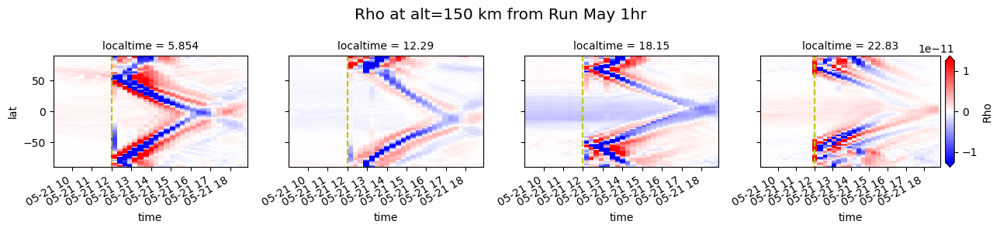

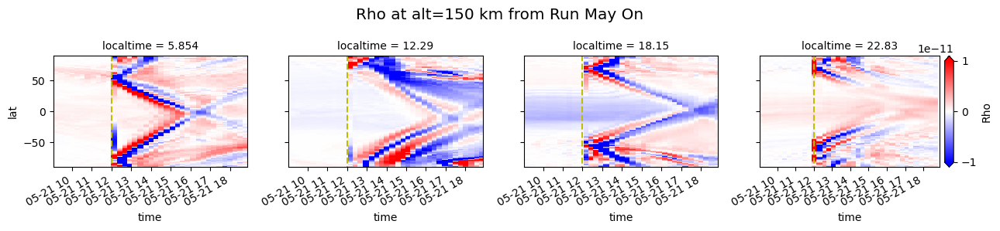

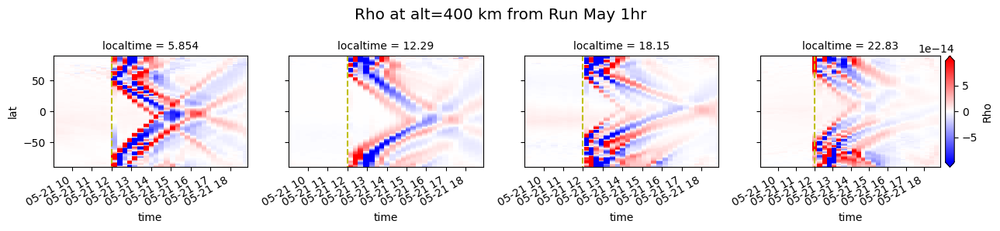

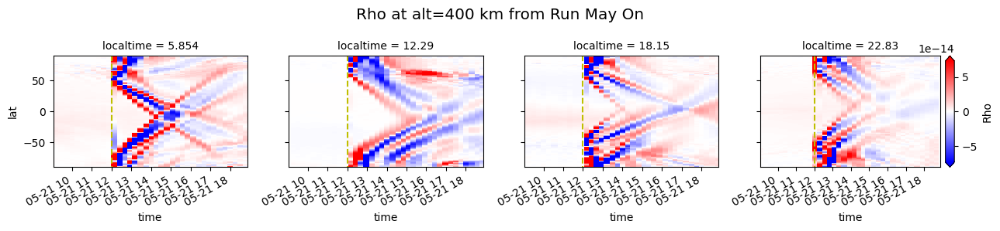

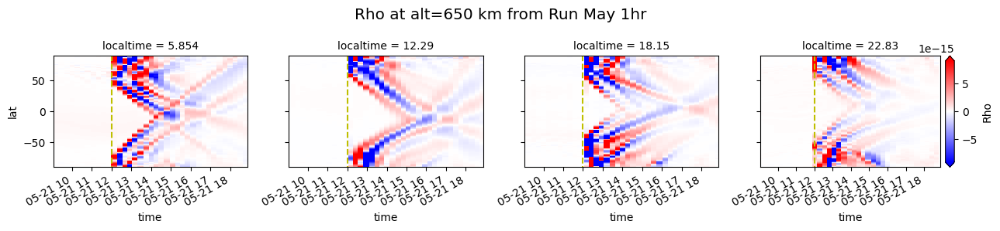

...

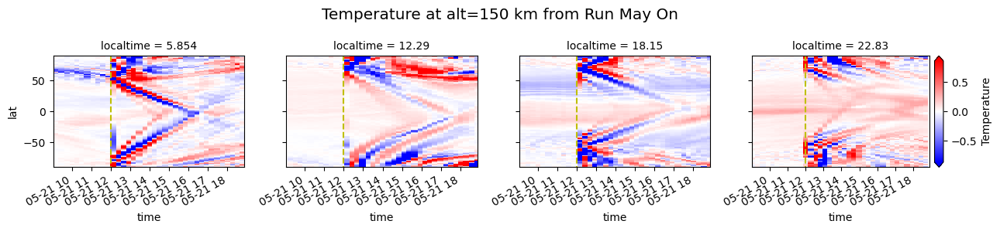

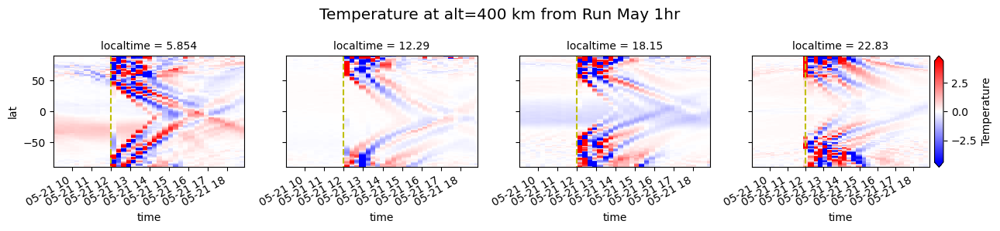

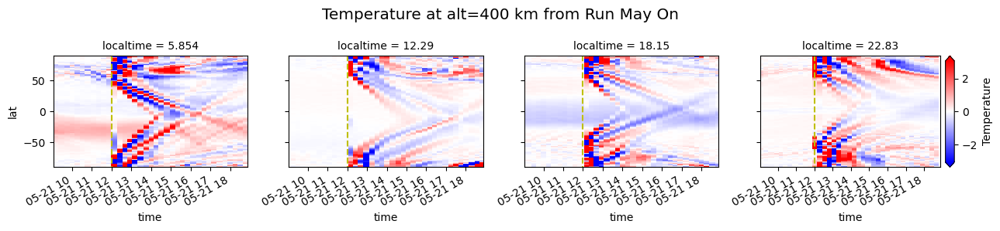

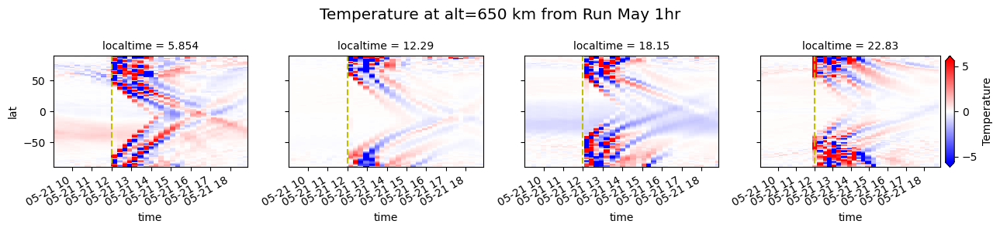

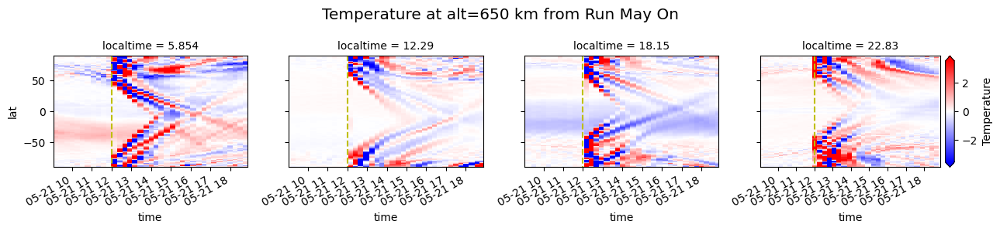

In [26]:
with tqdm(total=3*3*4) as pbar:
    for hrkey_old in gitms.keys():
        if 'hr' in hrkey_old:
            for col in gcols:
                for alt_now in alts:
                    for hrkey in [hrkey_old, hrkey_old.replace('1hr', 'on')]:

                        # print('here')
                        fig = utils.add_lt_to_dataset(filters.filter_xarray_DA_diff(
                            gitms[hrkey][col].sel(alt=alt_now, method='nearest')), localtimes=40).sel(localtime=lts_to_keo,
                                               method='nearest').plot(col='localtime',
                                                                      col_wrap=4,
                                                                      x='time', robust=True,
                                                                      cmap='bwr', add_colorbar=False,sharey=True)

                        divider = make_axes_locatable(plt.gca())
                        cax = divider.append_axes("right", "5%", pad="3%")
                        fig.add_colorbar(cax=cax)
                        s1 = format_colname_for_title(hrkey).split(' ')
                        s1 = ' '.join([s1[0], s1[3]])

                        fig.fig.suptitle('%s at alt=%i km from Run %s' %
                                         (col, alt_now, s1), fontsize='x-large')


                        for ax in fig.axs.flatten():
                            ax.axvline(pd.Timestamp('2011-11-21 12:00') if 'nov' in hrkey else pd.Timestamp('2011-05-21 12:00'),
                                       -90, 90, color='y',linestyle='--')



                        fig.fig.set_layout_engine('tight', )
                        plt.savefig('FinalDraftPlots/1hrvson/no_subtract/FILTERED-gitm-keos-'+hrkey+'-'+str(alt_now)+'-'+str(col), bbox_inches='tight')
                        pbar.update()
                        # raise

                
print('done')

In [ ]:
def duration_figs(da,
                  col,
                  alt_now,
                  hrkey,
                  savepath):
    fig = utils.add_lt_to_dataset(
        gitms[hrkey][col].sel(alt=alt_now, method='nearest'), localtimes=40).sel(localtime=lts_to_keo,
                                                                                 method='nearest').plot(
        col='localtime',
        col_wrap=4,
        x='time', robust=True,
        cmap='bwr', add_colorbar=False, sharey=True)

    divider = make_axes_locatable(plt.gca())
    cax = divider.append_axes("right", "5%", pad="3%")
    fig.add_colorbar(cax=cax)
    s1 = format_colname_for_title(hrkey).split(' ')
    s1 = ' '.join([s1[0], s1[3]])

    fig.fig.suptitle('%s at alt=%i km from Run %s' %
                     (col, alt_now, s1), fontsize='x-large')

    for ax in fig.axs.flatten():
        ax.axvline(pd.Timestamp('2011-11-21 12:00') if 'nov' in hrkey else pd.Timestamp('2011-05-21 12:00'),
                   -90, 90, color='y', linestyle='--')

    fig.fig.set_layout_engine('tight', )
    plt.savefig(savepath, bbox_inches='tight')

20it [13:51, 41.39s/it]                        /glade/work/abukowski/conda-envs/SAMI3-GITM/lib/python3.10/site-packages/xarray/plot/facetgrid.py:218: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axs = plt.subplots(
36it [24:54, 41.53s/it]


done


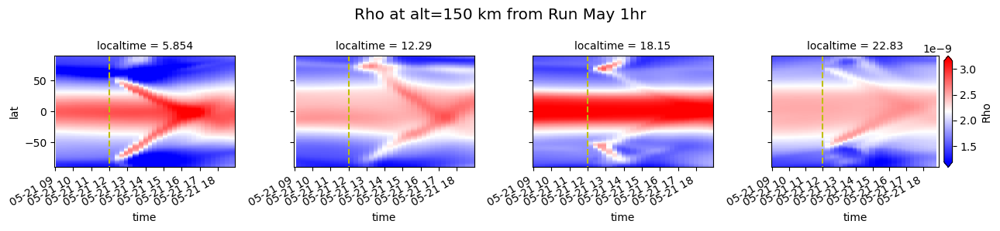

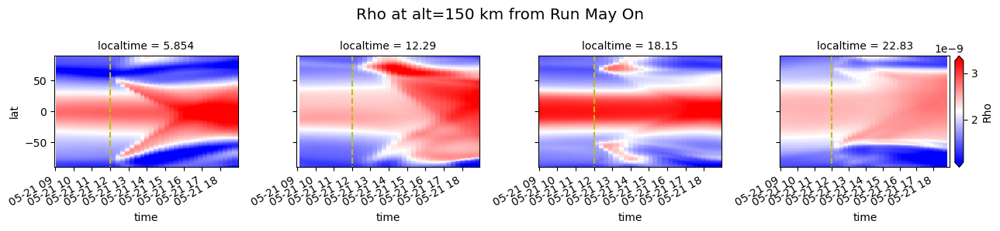

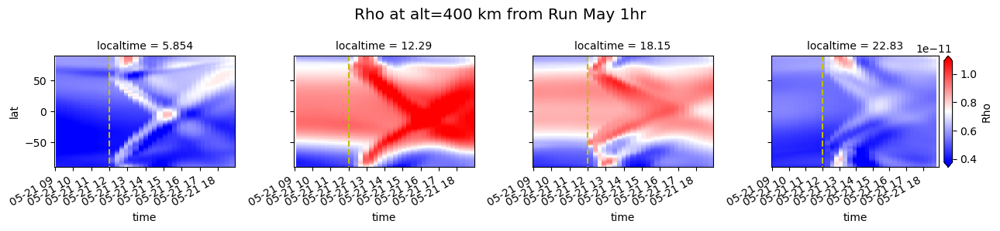

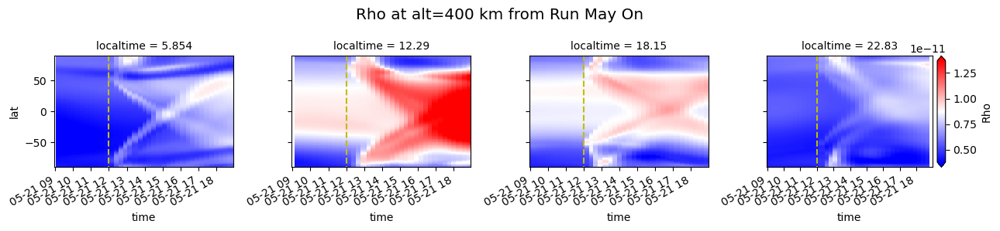

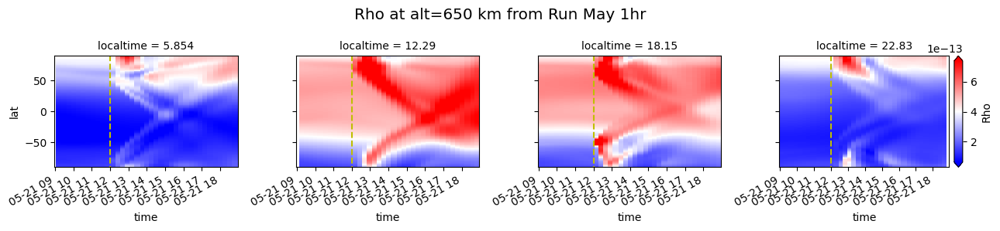

...

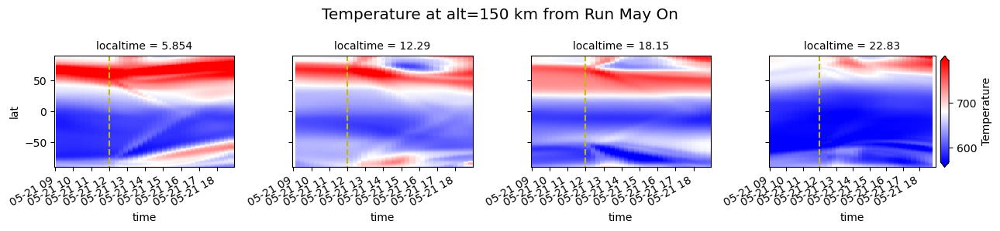

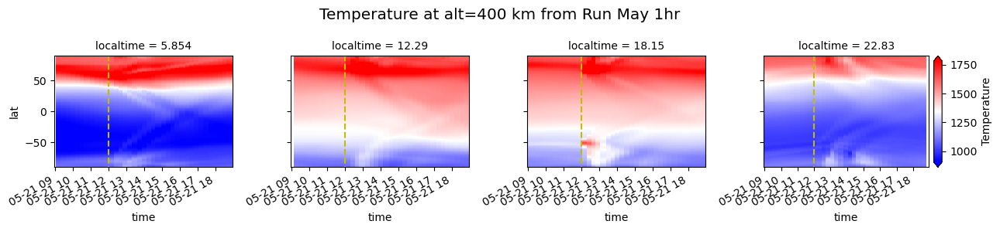

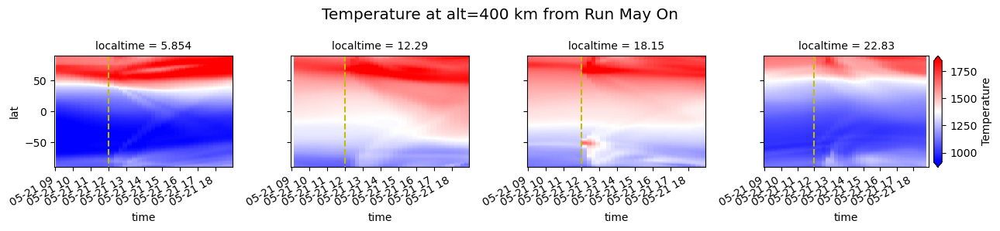

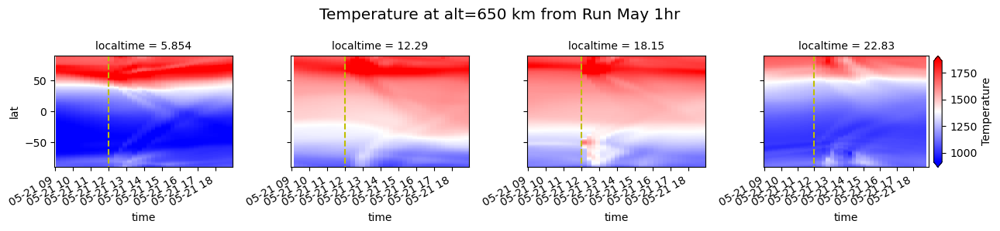

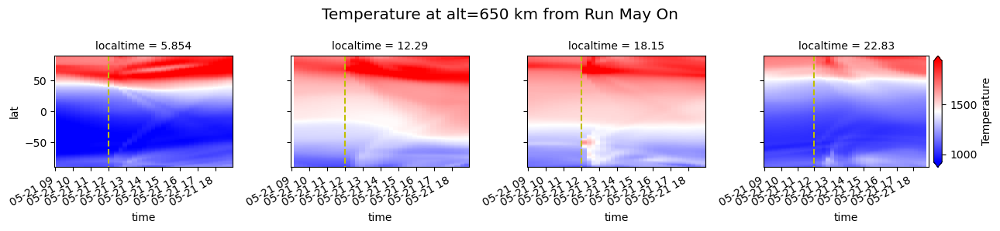

In [27]:
with tqdm(total=3*3*2) as pbar:
    for hrkey_old in gitms.keys():
        if 'hr' in hrkey_old:
            for col in gcols:
                for alt_now in alts:
                    for hrkey in [hrkey_old, hrkey_old.replace('1hr', 'on')]:
                        fig = utils.add_lt_to_dataset(
                            gitms[hrkey][col].sel(alt=alt_now, method='nearest'), localtimes=40).sel(localtime=lts_to_keo,
                                               method='nearest').plot(col='localtime',
                                                                      col_wrap=4,
                                                                      x='time', robust=True,
                                                                      cmap='bwr', add_colorbar=False,sharey=True)

                        divider = make_axes_locatable(plt.gca())
                        cax = divider.append_axes("right", "5%", pad="3%")
                        fig.add_colorbar(cax=cax)
                        s1 = format_colname_for_title(hrkey).split(' ')
                        s1 = ' '.join([s1[0], s1[3]])

                        fig.fig.suptitle('%s at alt=%i km from Run %s' %
                                         (col, alt_now, s1), fontsize='x-large')


                        for ax in fig.axs.flatten():
                            ax.axvline(pd.Timestamp('2011-11-21 12:00') if 'nov' in hrkey else pd.Timestamp('2011-05-21 12:00'),
                                       -90, 90, color='y',linestyle='--')



                        fig.fig.set_layout_engine('tight', )
                        plt.savefig('FinalDraftPlots/1hrvson/no_subtract/gitm-keos-'+hrkey+'-'+str(alt_now)+'-'+str(col), bbox_inches='tight')
                        pbar.update()
                    # raise

                
print('done')

# Bz Comparisons:

In [57]:
bzkeys = np.sort([k for k in gitms.keys() if 'bz' in k])

In [58]:
bzkeys

array(['nov-ut12-storm-on-bz15-byneg', 'nov-ut12-storm-on-bz15-bypos',
       'nov-ut12-storm-on-bz17', 'nov-ut12-storm-on-bz8-byneg',
       'nov-ut12-storm-on-bz8-bypos'], dtype='<U28')

In [59]:
# Before the storm all will be the same:
## Only need one plot of this:

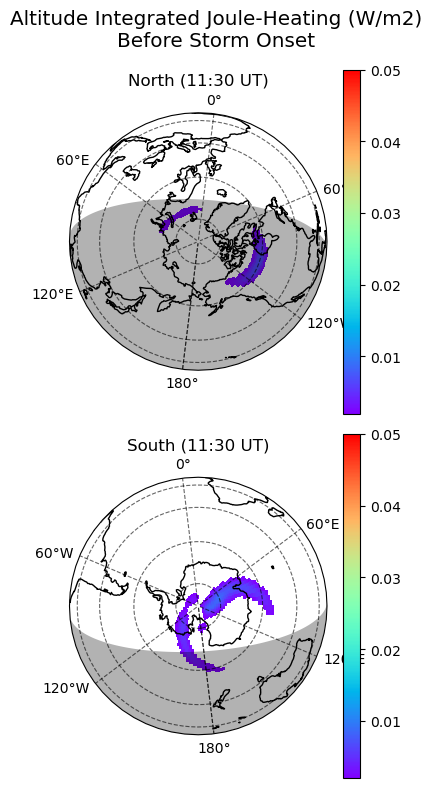

In [61]:
fig = plotting_routines.loop_panels(
    gitms[bzkeys[0]].AltIntJouleHeating_W_m2,
    ncols=1,
    lon_labels=True,
    mask_dials=0.002,
    vmax=0.05,
    cmap='rainbow',
    start_time=pd.Timestamp('2011-11-21 11:30'))

fig.suptitle('Altitude Integrated Joule-Heating (W/m2)\nBefore Storm Onset', fontsize='x-large')
fig.tight_layout()
# fig.show()
fig.savefig('good-plots/jh-rotb/before', bbox_inches='tight')

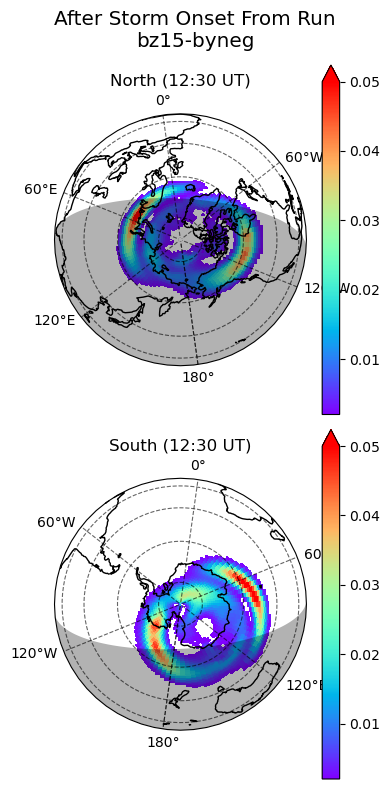

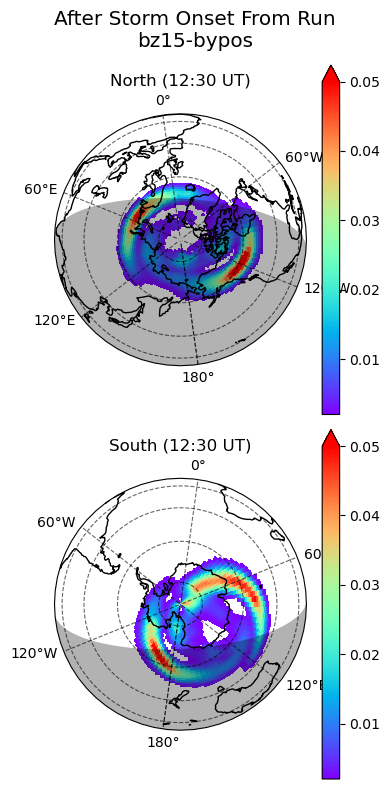

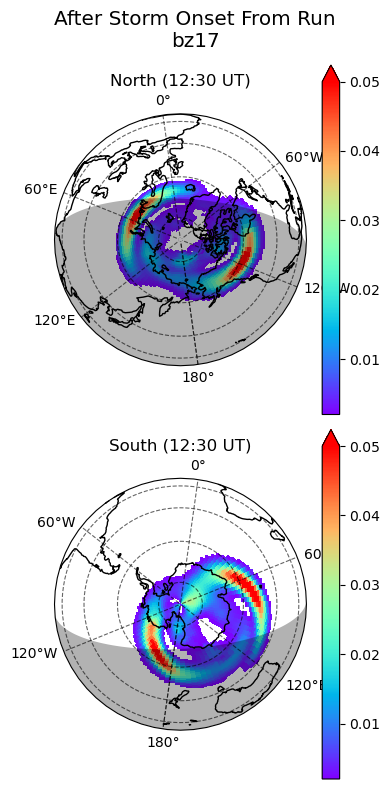

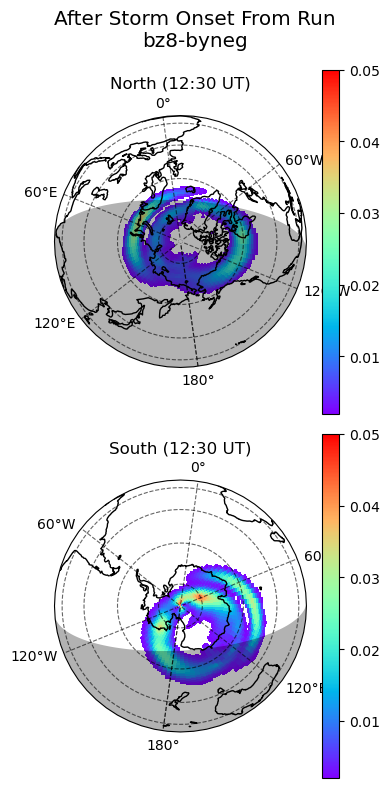

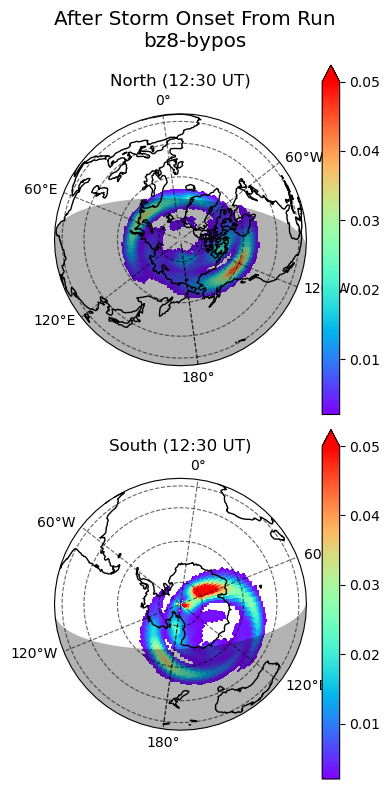

In [62]:

for col in bzkeys:
    fig = plotting_routines.loop_panels(
        gitms[col].AltIntJouleHeating_W_m2,
        ncols=1,
        lon_labels=True,
        mask_dials=0.002,
        vmax=0.05,
        cmap='rainbow',
        start_time=pd.Timestamp('2011-11-21 12:30'),)

    fig.suptitle('After Storm Onset From Run\n%s'%col[col.find('bz'):], fontsize='x-large')
    fig.tight_layout()
    # fig.show()
    fig.savefig('good-plots/jh-rotb/after-%s'%col[col.find('bz'):], bbox_inches='tight');

In [12]:
bzkeys[0], bzkeys[1], bzkeys[3], bzkeys[4]

('nov-ut12-storm-on-bz15-byneg',
 'nov-ut12-storm-on-bz15-bypos',
 'nov-ut12-storm-on-bz8-byneg',
 'nov-ut12-storm-on-bz8-bypos')

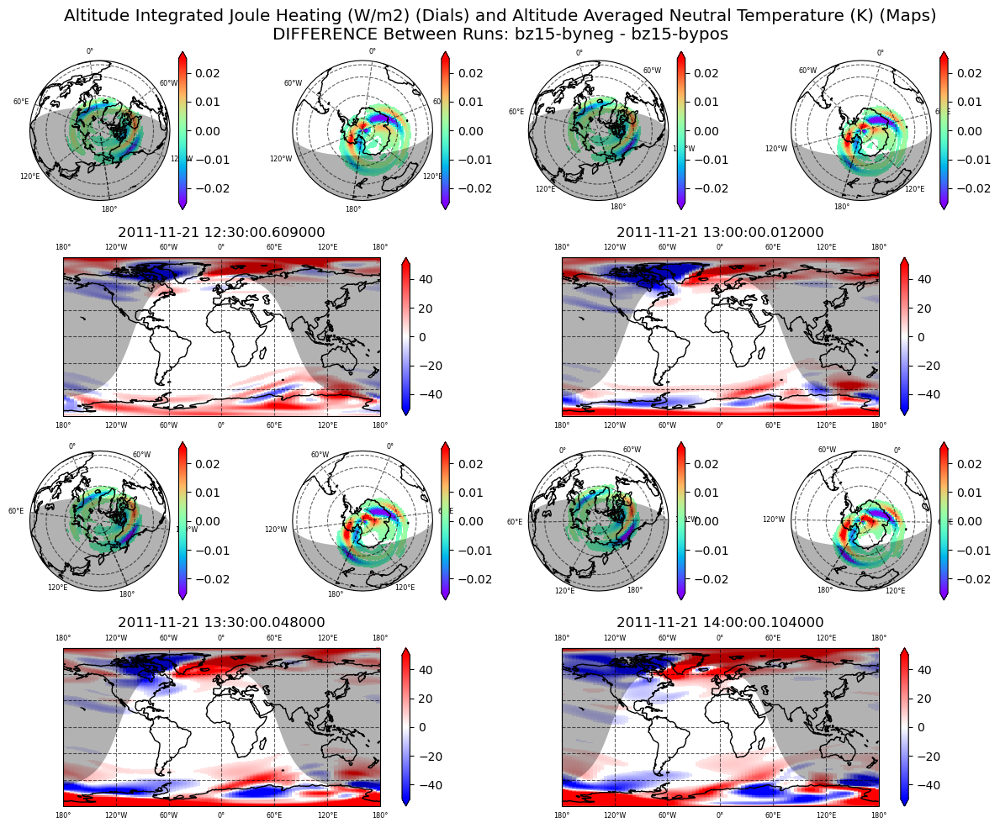

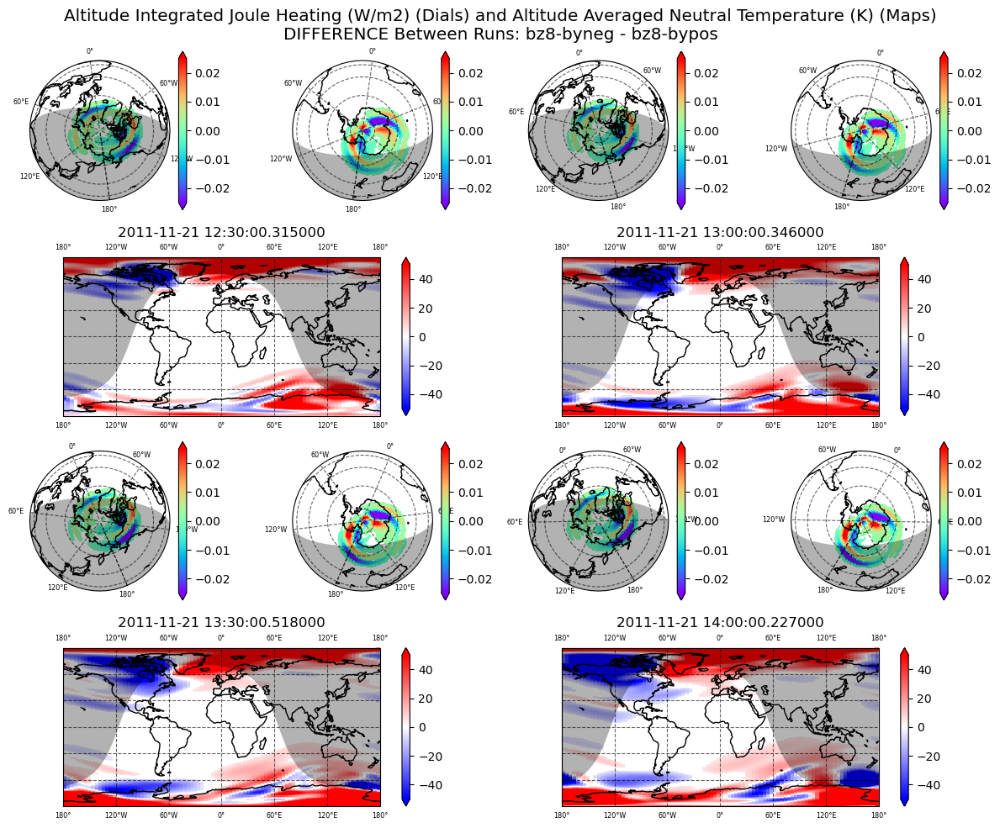

In [69]:
for i, j in [[0, 1], [3, 4]]:
    
    fig = plotting_routines.map_and_dials(
        (gitms[bzkeys[i]]- gitms[bzkeys[j]].reindex_like(
             gitms[bzkeys[i]], method='nearest')).AltIntJouleHeating_W_m2,
        4,
        max_per_row=2,
        time_start=pd.Timestamp('2011-11-21 12:30'),
        time_delta=pd.Timedelta('30 minutes'),
        map_da=(gitms[bzkeys[i]] 
                - gitms[bzkeys[j]].reindex_like(gitms[bzkeys[i]],
                                                method='nearest')).Temperature.mean('alt'),
        mask_maps=5,
        map_cmap='bwr',
        vmin_map=-50,
        vmax_map=50,
        vmin_dial=-.025,
        vmax_dial=0.025,latlon_labeled=True)
    
    fig.suptitle('Altitude Integrated Joule Heating (W/m2) (Dials) and Altitude Averaged Neutral Temperature (K) (Maps)\n'
        'DIFFERENCE Between Runs: %s - %s' % (
            bzkeys[i][bzkeys[i].find('bz'):], bzkeys[j][bzkeys[j].find('bz'):]), fontsize='x-large')
    fig.tight_layout()
    fig.savefig('good-plots/jh-rotb/jh_and_tempdiff-' + bzkeys[j][bzkeys[j].find('bz'):], bbox_inches='tight')
    # break

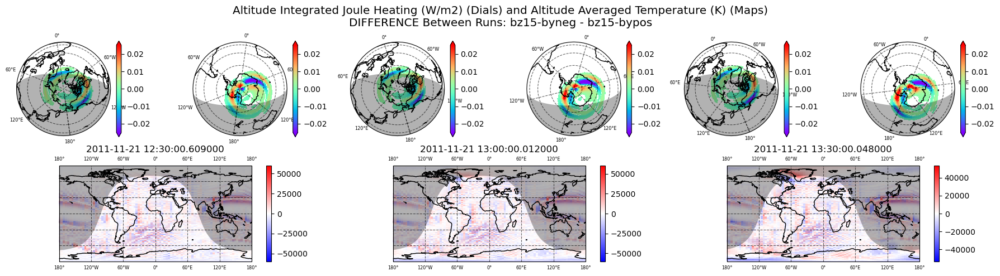

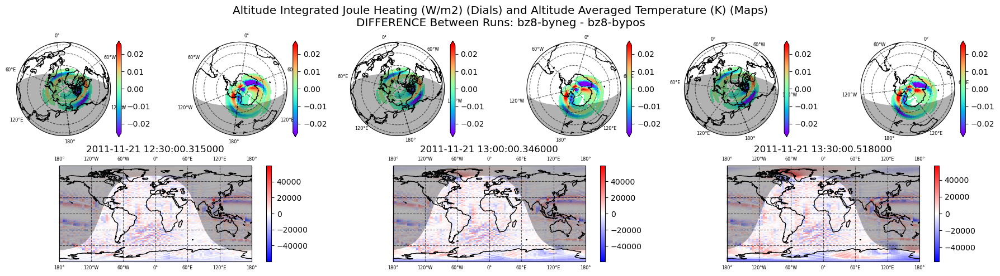

In [67]:
for i, j in [[0, 1], [3, 4]]:
    
    fig = plotting_routines.map_and_dials(
        (gitms[bzkeys[i]]- gitms[bzkeys[j]].reindex_like(
             gitms[bzkeys[i]], method='nearest')).AltIntJouleHeating_W_m2,
        3,
        max_per_row=3,
        time_start=pd.Timestamp('2011-11-21 12:30'),
        time_delta=pd.Timedelta('30 minutes'),
        map_da=(samis[bzkeys[i]] 
                - samis[bzkeys[j]].reindex_like(samis[bzkeys[i]],
                                                method='nearest')).edens.mean('alt'),
        # mask_maps=5,
        map_cmap='bwr',
        # vmin_map=-50,
        # vmax_map=50,
        vmin_dial=-.025,
        vmax_dial=0.025,latlon_labeled=True)
    
    fig.suptitle('Altitude Integrated Joule Heating (W/m2) (Dials) and Altitude Averaged Temperature (K) (Maps)\n'
        'DIFFERENCE Between Runs: %s - %s' % (
            bzkeys[i][bzkeys[i].find('bz'):], bzkeys[j][bzkeys[j].find('bz'):]), fontsize='x-large')
    fig.tight_layout()
    fig.show()# savefig('good-plots/jh-rotb/jh_and_edensdiff-' + bzkeys[j][bzkeys[j].find('bz'):], bbox_inches='tight')
    # break

## Amplitude:

In [7]:
ampkeys = ['may-ut12-storm-on-full', 'may-ut12-storm-on-half',
           'nov-ut12-storm-on-full', 'nov-ut12-storm-on-half']

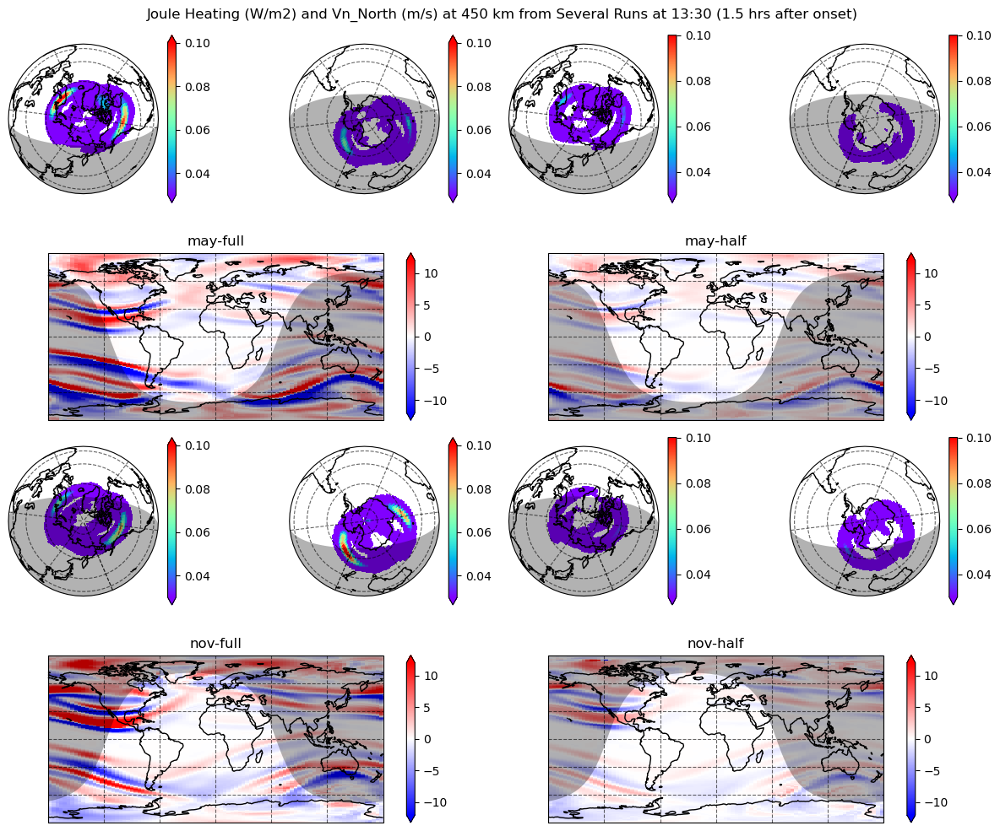

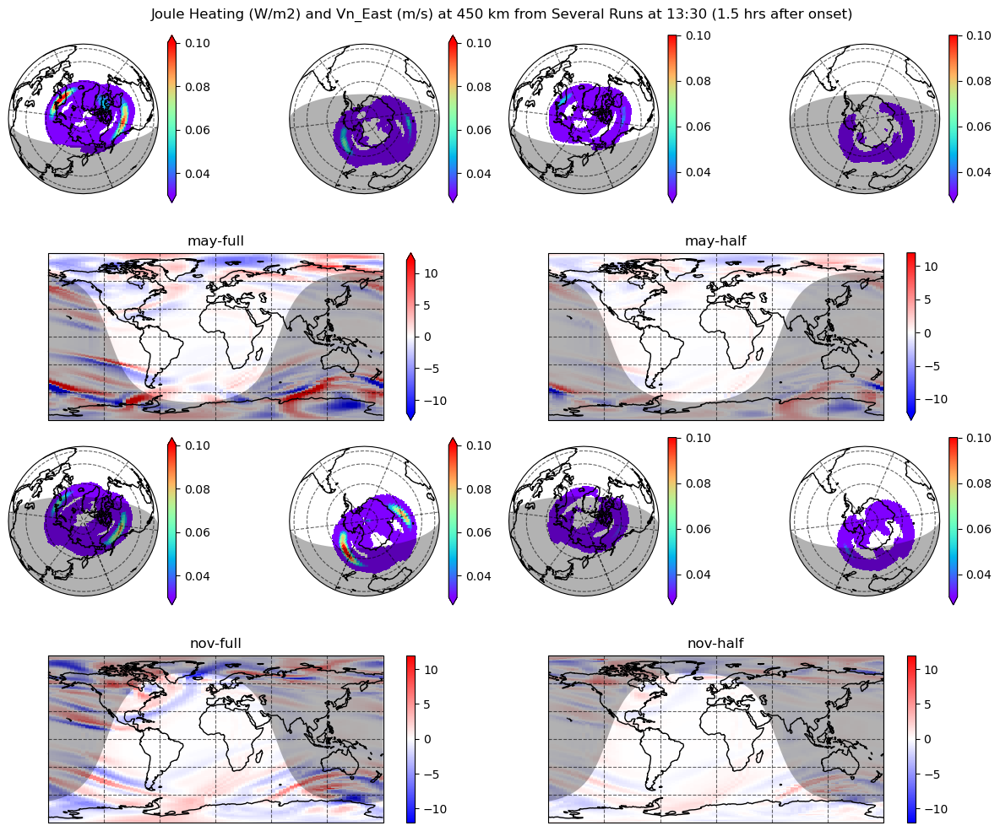

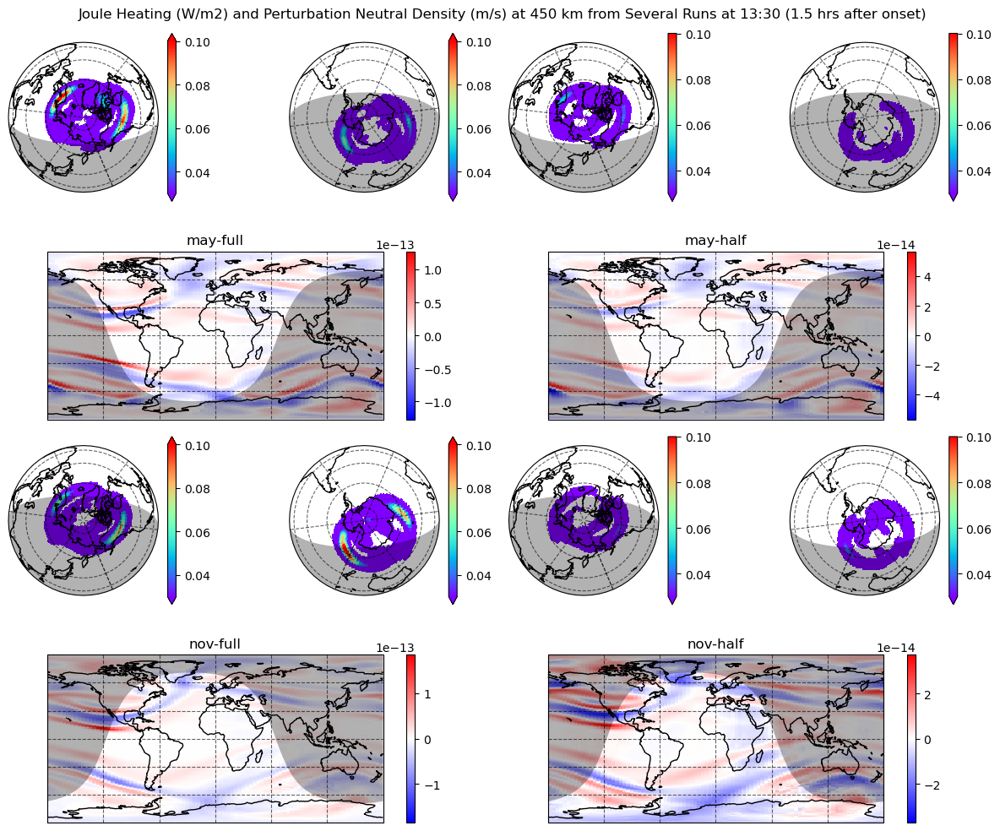

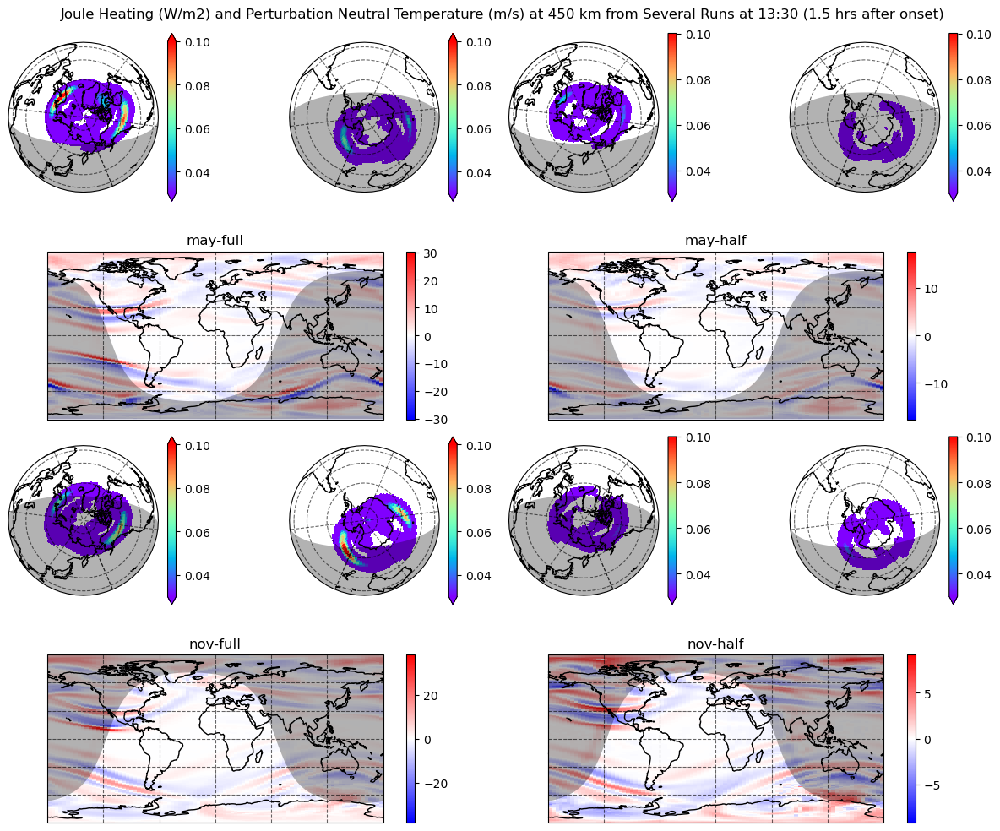

In [39]:
itime = 54
a = 450
times = []


map_data = xr.Dataset()
dial_data = xr.Dataset()
titles = []

for k in ampkeys:
    
    newkey = '-'.join([k.split('-')[0], k.split('-')[-1]])
    dial_data[newkey] = gitms[k].AltIntJouleHeating_W_m2.isel(time=itime)#.reindex_like(gitms['may-full'], fill_value=19)
    map_data[newkey] = filters.filter_xarray_DA_diff(
        gitms[k].Vn_north.sel(alt=a, method='nearest'),
        percent=False,
        label='lower',
        order=2).isel(time=itime)
    times.append(gitms[k].time.values[itime])
    
    

fig = plotting_routines.map_and_dials(dial_da=dial_data,
                                        total=4,
                                        map_da=map_data,
                                        max_per_row=2, mask_dials=0.002,
                                        suptitle='Joule Heating (W/m2) and Vn_North (m/s) at %i km from Several Runs at 13:30 (1.5 hrs after onset)' %(a),
                                        map_cmap='bwr', vmin_dial=0.03, vmax_dial=.10, vmin_map=-12, vmax_map=12,
                                      several_datasets=True, times_datasets=times)
    
fig.show()





map_data = xr.Dataset()
dial_data = xr.Dataset()
titles = []

for k in ampkeys:
    
    newkey = '-'.join([k.split('-')[0], k.split('-')[-1]])

    dial_data[newkey] = gitms[k].AltIntJouleHeating_W_m2.isel(time=itime)
    map_data[newkey] = filters.filter_xarray_DA_diff(
        gitms[k].Vn_east.sel(alt=a, method='nearest'), percent=False, label='lower', order=2).isel(time=itime)
    times.append(gitms[k].time.values[itime])
    

fig = plotting_routines.map_and_dials(dial_da=dial_data,
                                        total=4,
                                        map_da=map_data,
                                        max_per_row=2, mask_dials=0.002,
                                        suptitle='Joule Heating (W/m2) and Vn_East (m/s) at %i km from Several Runs at 13:30 (1.5 hrs after onset)' %(a),
                                        map_cmap='bwr', vmin_dial=0.03, vmax_dial=.10, vmin_map=-12, vmax_map=12, 
                                      several_datasets=True, times_datasets=times)
    
fig.show()

map_data = xr.Dataset()
dial_data = xr.Dataset()
titles = []

for k in ampkeys:
    
    newkey = '-'.join([k.split('-')[0], k.split('-')[-1]])

    dial_data[newkey] = gitms[k].AltIntJouleHeating_W_m2.isel(time=itime)
    map_data[newkey] = filters.filter_xarray_DA_diff(
        gitms[k].Rho.sel(alt=a, method='nearest'), percent=False, label='lower', order=2).isel(time=itime)
    times.append(gitms[k].time.values[itime])
    

fig = plotting_routines.map_and_dials(dial_da=dial_data,
                                        total=4,
                                        map_da=map_data,
                                        max_per_row=2, mask_dials=0.002,
                                        suptitle='Joule Heating (W/m2) and Perturbation Neutral Density (m/s) at %i km from Several Runs at 13:30 (1.5 hrs after onset)' %(a),
                                        map_cmap='bwr', vmin_dial=0.03, vmax_dial=.10, 
                                      several_datasets=True, times_datasets=times)
    
fig.show()

map_data = xr.Dataset()
dial_data = xr.Dataset()
titles = []

for k in ampkeys:
    
    newkey = '-'.join([k.split('-')[0], k.split('-')[-1]])

    dial_data[newkey] = gitms[k].AltIntJouleHeating_W_m2.isel(time=itime)
    map_data[newkey] = filters.filter_xarray_DA_diff(
        gitms[k].Temperature.sel(alt=a, method='nearest'), percent=False, label='lower', order=2).isel(time=itime)
    times.append(gitms[k].time.values[itime])
    

fig = plotting_routines.map_and_dials(dial_da=dial_data,
                                        total=4,
                                        map_da=map_data,
                                        max_per_row=2, mask_dials=0.002,
                                        suptitle='Joule Heating (W/m2) and Perturbation Neutral Temperature (m/s) at %i km from Several Runs at 13:30 (1.5 hrs after onset)' %(a),
                                        map_cmap='bwr', vmin_dial=0.03, vmax_dial=.10, vmin_map=-12, vmax_map=12, 
                                      several_datasets=True, times_datasets=times)
    
fig.show()


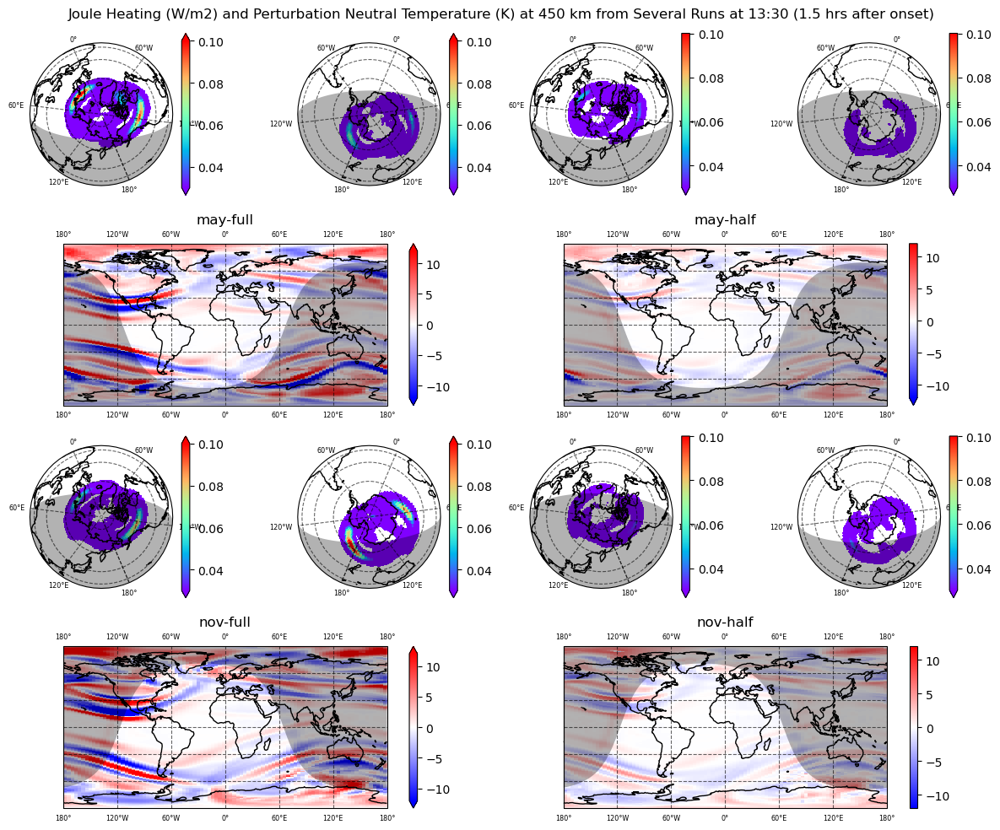

In [43]:
map_data = xr.Dataset()
dial_data = xr.Dataset()
titles = []

for k in ampkeys:
    
    newkey = '-'.join([k.split('-')[0], k.split('-')[-1]])

    dial_data[newkey] = gitms[k].AltIntJouleHeating_W_m2.isel(time=itime)
    map_data[newkey] = filters.filter_xarray_DA_diff(
        gitms[k].Temperature.sel(alt=a, method='nearest'), percent=False, label='lower', order=2).isel(time=itime)
    times.append(gitms[k].time.values[itime])
    

fig = plotting_routines.map_and_dials(dial_da=dial_data,
                                        total=4,
                                        map_da=map_data,
                                        max_per_row=2, mask_dials=0.002,
                                        suptitle='Joule Heating (W/m2) and Perturbation Neutral Temperature (K) at %i km from Several Runs at 13:30 (1.5 hrs after onset)' %(a),
                                        map_cmap='bwr', vmin_dial=0.03, vmax_dial=.10, vmin_map=-12, vmax_map=12, 
                                      several_datasets=True, times_datasets=times, latlon_labeled=True)
    
fig.show()
fig.savefig('good-plots/jh-temp-gitm-amplitude_and_season')

In [111]:
plotting_routines = importlib.reload(plotting_routines)

/glade/u/home/abukowski/Documents/CEDAR2023/utility_programs/plotting_routines.py:13: FutureWarning: The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.
  world = geopandas.read_file(geopandas.datasets.get_path("naturalearth_lowres"))


/glade/u/home/abukowski/Documents/CEDAR2023/utility_programs/plotting_routines.py:686: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()
/glade/scratch/abukowski/ipykernel_56342/3025184575.py:48: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()


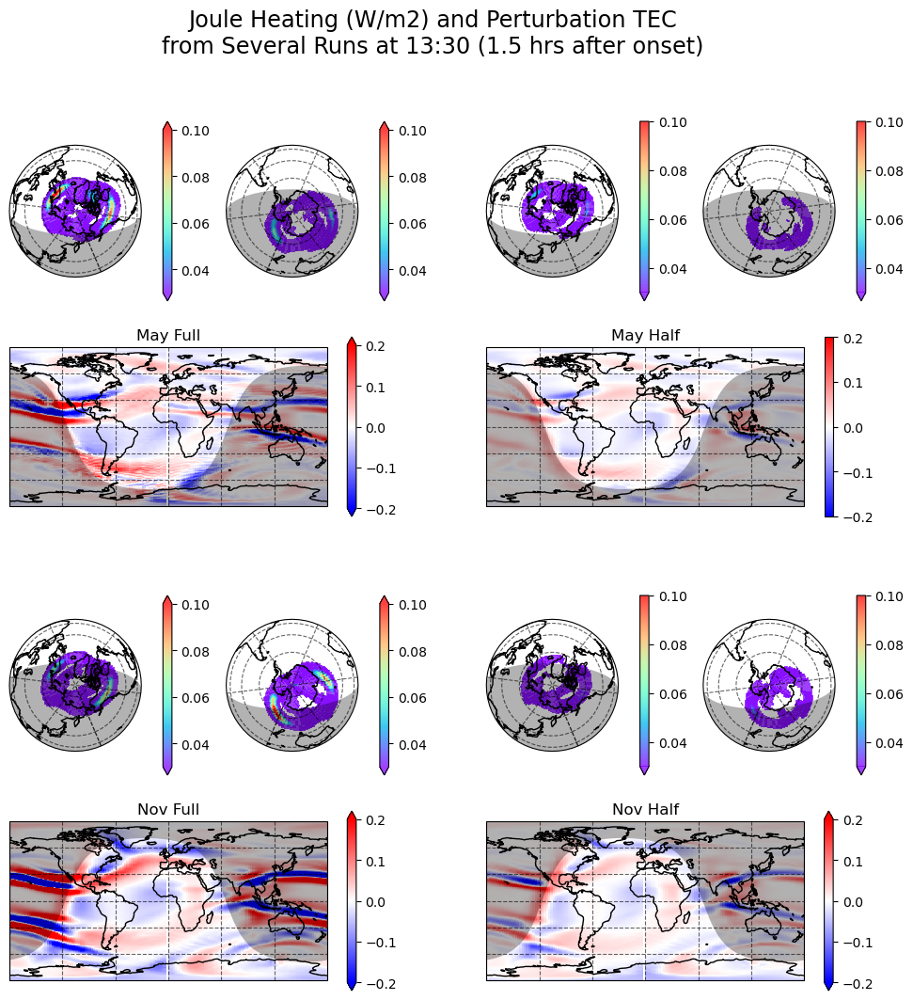

In [127]:
itime = 54
a = 800
times = []

ampkeys = ['may-ut12-storm-on-full', 'may-ut12-storm-on-half',
           'nov-ut12-storm-on-full', 'nov-ut12-storm-on-half']


map_data = xr.Dataset()
dial_data = xr.Dataset()

for k in ampkeys:
    
    newkey = '-'.join([k.split('-')[0], k.split('-')[-1]])
    dial_data[newkey] = gitms[k].AltIntJouleHeating_W_m2.isel(time=itime)#.reindex_like(gitms['may-full'], fill_value=19)
    
    # if len(map_data.data_vars) ==0:
    #     map_data[format_colname_for_title(newkey)] = filters.filter_xarray_DA_diff(
    #         # samis[k].edens.sel(alt=a, method='nearest'),
    #         samis[k].edens.integrate('alt'),
    #         percent=False,
    #         label='lower',
    #         order=2).isel(time=itime)
    # else:
    map_data[format_colname_for_title(newkey)] = filters.filter_xarray_DA_diff(
        # samis[k].edens.sel(alt=a, method='nearest'),
        samis[k].edens.integrate('alt')*1e-7,
        percent=False,
        label='lower',
        order=2).isel(time=itime).interp({'lat':np.arange(-90,90,.1),
                                          'lon':np.arange(0,360,.25)}, method='linear').coarsen(lat=10, lon=10).mean()
    times.append(samis[k].time.values[itime])
    
    

fig =  plotting_routines.map_and_dials(dial_da=dial_data,
                                        total=4,
                                        map_da=map_data,
                                        max_per_row=2, mask_dials=0.002,
                                        
                                        map_cmap='bwr', vmin_dial=0.03, vmax_dial=.10, vmin_map=-.20, vmax_map=.20,
                                       dial_kwargs={'alpha':0.75},
                                       #map_kwargs={'robust': True},
                                      several_datasets=True, times_datasets=times,
                                       suptitle='Joule Heating (W/m2) and Perturbation TEC\nfrom Several Runs at 13:30 (1.5 hrs after onset)' ,
                                       suptitlesize='xx-large')

fig.tight_layout()

fig.show()



# fig.savefig('good-plots/jh-edens-800km_amp-n-season', bbox_inches='tight')



/glade/u/home/abukowski/Documents/CEDAR2023/utility_programs/plotting_routines.py:686: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()
/glade/scratch/abukowski/ipykernel_56342/1838305249.py:39: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()


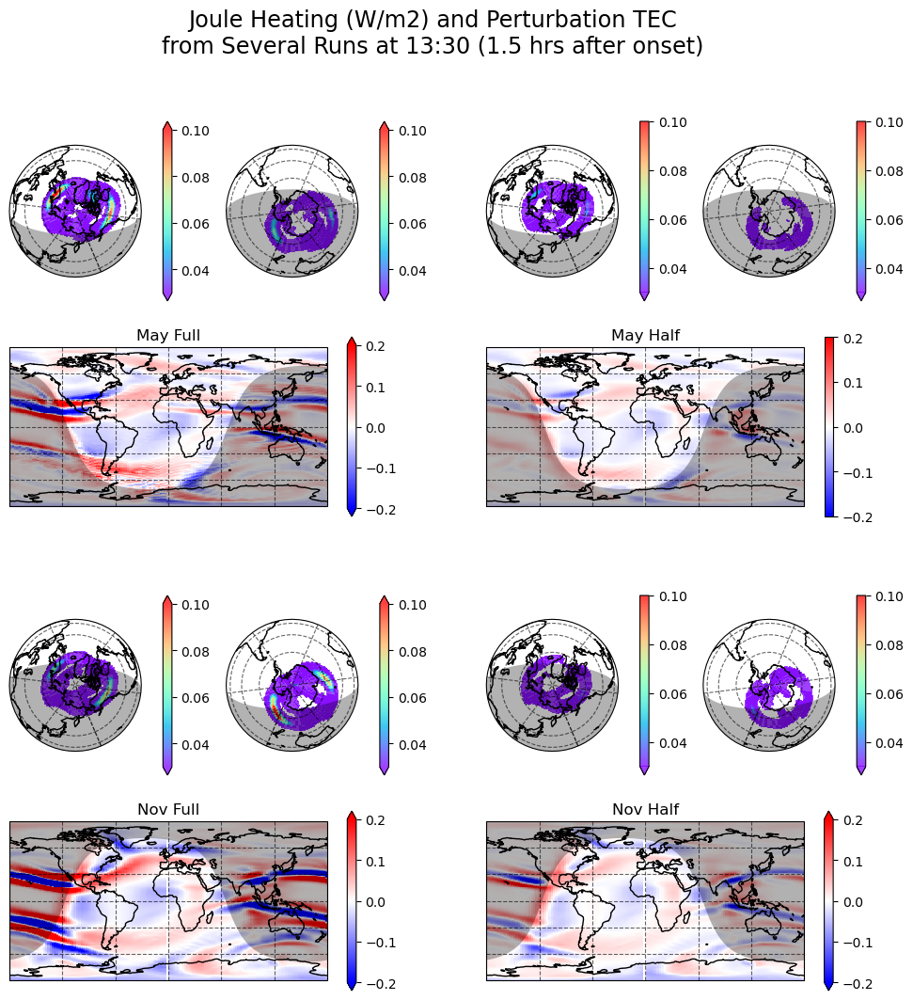

In [151]:
itime = 54
a = 800
times = []

ampkeys = ['may-ut12-storm-on-full', 'may-ut12-storm-on-half',
           'nov-ut12-storm-on-full', 'nov-ut12-storm-on-half']


map_data = xr.Dataset()
dial_data = xr.Dataset()

for k in ampkeys:
    
    newkey = '-'.join([k.split('-')[0], k.split('-')[-1]])
    dial_data[newkey] = gitms[k].AltIntJouleHeating_W_m2.isel(time=itime)#.reindex_like(gitms['may-full'], fill_value=19)
    

    map_data[format_colname_for_title(newkey)] = (filters.filter_xarray_DA_diff(
        # samis[k].edens.sel(alt=a, method='nearest'),
        samis[k].edens.integrate('alt'),
        percent=False,
        label='lower',
        order=2)/1e7).isel(time=itime-1).interp({'lat':np.arange(-90,90,.1),
                                          'lon':np.arange(-2,362,.25)}, method='linear').coarsen(lat=10, lon=10, boundary='trim').mean()
    times.append(samis[k].time.values[itime])

fig =  plotting_routines.map_and_dials(dial_da=dial_data,
                                        total=4,
                                        map_da=map_data,
                                        max_per_row=2, mask_dials=0.002,
                                        
                                        map_cmap='bwr', vmin_dial=0.03, vmax_dial=.10, vmin_map=-.2, vmax_map=.2,
                                       dial_kwargs={'alpha':0.75}, latlon_labeled=False, 
                                       # map_kwargs={'robust': True},
                                      several_datasets=True, times_datasets=times,
                                       suptitle='Joule Heating (W/m2) and Perturbation TEC\nfrom Several Runs at 13:30 (1.5 hrs after onset)' ,
                                       suptitlesize='xx-large')

fig.tight_layout()

fig.show()

# fig.savefig("FinalDraftPlots/TEC_Amplitude_Jh_unlabeled-changetecunits", bbox_inches='tight')



In [147]:
map_data.time

<xarray.DataArray 'time' ()>
array('2011-05-21T13:30:00.000000000', dtype='datetime64[ns]')
Coordinates:
    time     datetime64[ns] 2011-05-21T13:30:00

In [148]:
dial_data.time

<xarray.DataArray 'time' ()>
array('2011-05-21T13:30:00.404000000', dtype='datetime64[ns]')
Coordinates:
    time     datetime64[ns] 2011-05-21T13:30:00.404000

/glade/u/home/abukowski/Documents/CEDAR2023/utility_programs/plotting_routines.py:686: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()
/glade/scratch/abukowski/ipykernel_56342/253869995.py:29: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()


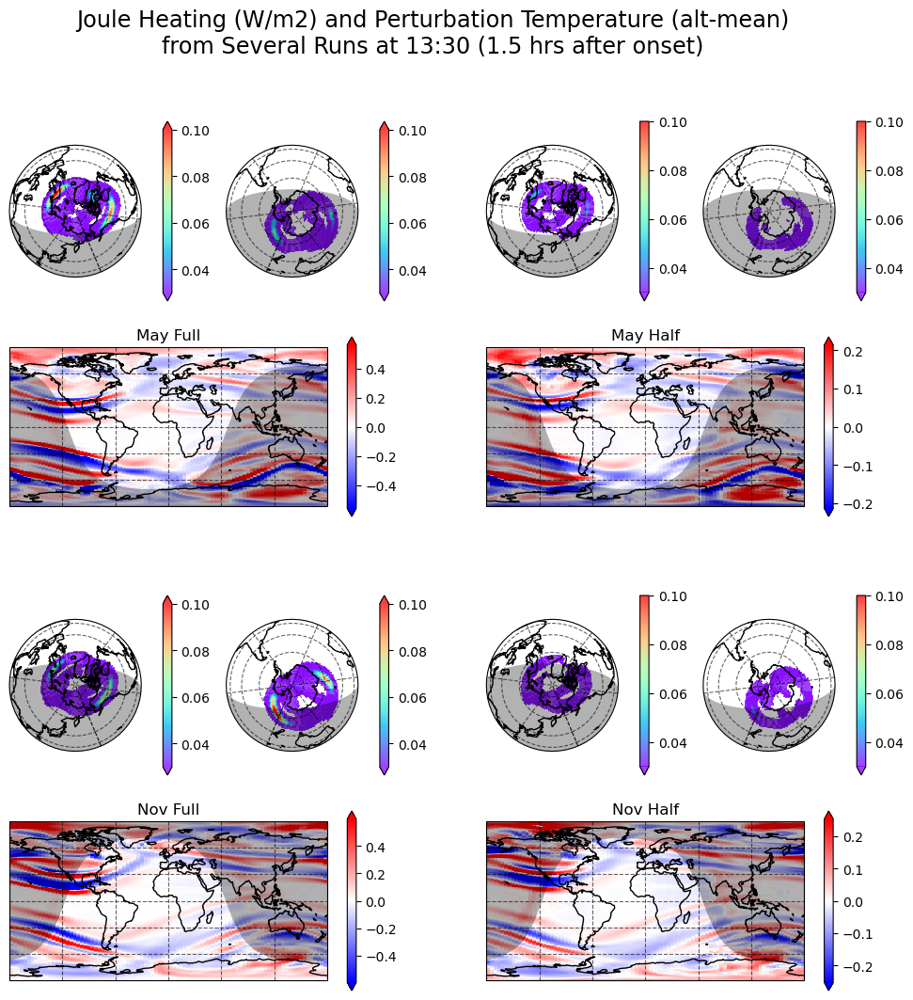

In [133]:

map_data = xr.Dataset()
dial_data = xr.Dataset()

for k in ampkeys:
    
    newkey = '-'.join([k.split('-')[0], k.split('-')[-1]])
    dial_data[newkey] = gitms[k].AltIntJouleHeating_W_m2.isel(time=itime)#.reindex_like(gitms['may-full'], fill_value=19)
    

    map_data[format_colname_for_title(newkey)] = filters.filter_xarray_DA_diff(
        # samis[k].edens.sel(alt=a, method='nearest'),
        gitms[k].Temperature.mean('alt'),
        percent=True,
        label='lower',
        order=2).isel(time=itime)
    times.append(gitms[k].time.values[itime])

fig =  plotting_routines.map_and_dials(dial_da=dial_data,
                                        total=4,
                                        map_da=map_data,
                                        max_per_row=2, mask_dials=0.002,
                                        map_cmap='bwr', vmin_dial=0.03, vmax_dial=.10, 
                                       dial_kwargs={'alpha':0.75},
                                       map_kwargs={'robust': True},
                                      several_datasets=True, times_datasets=times,
                                       suptitle='Joule Heating (W/m2) and Perturbation Temperature (alt-mean)\nfrom Several Runs at 13:30 (1.5 hrs after onset)' ,
                                       suptitlesize='xx-large')

fig.tight_layout()

fig.show()


# fig.savefig('good-plots/jh-edens-800km_amp-n-season', bbox_inches='tight')


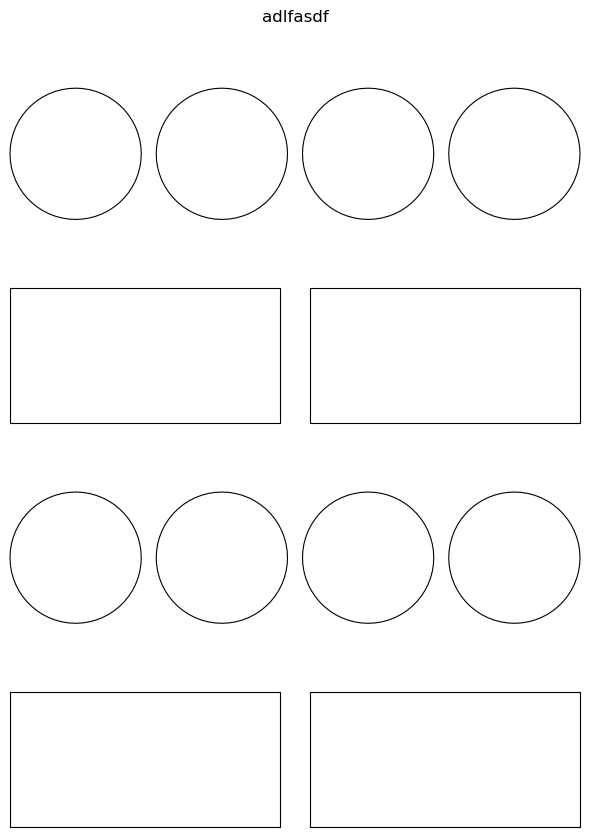

In [123]:
time_here = pd.Timestamp(dial_data.time.values)

lons = np.arange(0, 360)
lts = ut_to_lt([time_here], lons)
central_lon = lons[np.argmin(np.abs(24-lts))]

fig = plt.figure(figsize=(6,9))

ax0 = fig.add_subplot(4,4,1, projection=ccrs.Orthographic(central_lon, 90))
ax1 = fig.add_subplot(4,4,2, projection=ccrs.Orthographic(central_lon, 90))
ax2 = fig.add_subplot(4,4,3, projection=ccrs.Orthographic(central_lon, 90))
ax3 = fig.add_subplot(4,4,4, projection=ccrs.Orthographic(central_lon, 90))

ax4 = fig.add_subplot(4,2,3, projection=ccrs.PlateCarree())
ax5 = fig.add_subplot(4,2,4, projection=ccrs.PlateCarree())



ax6 = fig.add_subplot(4,4,9, projection=ccrs.Orthographic(central_lon, 90))
ax7 = fig.add_subplot(4,4,10, projection=ccrs.Orthographic(central_lon, 90))
ax8 = fig.add_subplot(4,4,11, projection=ccrs.Orthographic(central_lon, 90))
ax9 = fig.add_subplot(4,4,12, projection=ccrs.Orthographic(central_lon, 90))

ax10 = fig.add_subplot(4,2,7, projection=ccrs.PlateCarree())
ax11 = fig.add_subplot(4,2,8, projection=ccrs.PlateCarree())


fig.suptitle('adlfasdf')
fig.tight_layout()
fig.show()

In [68]:
map_data

<xarray.Dataset>
Dimensions:   (lat: 90, lon: 72)
Coordinates:
    time      datetime64[ns] 2011-05-21T13:35:00
  * lat       (lat) float64 -89.05 -87.05 -85.05 -83.05 ... 84.95 86.95 88.95
  * lon       (lon) float64 2.375 7.375 12.38 17.38 ... 342.4 347.4 352.4 357.4
Data variables:
    May Full  (lat, lon) float64 dask.array<chunksize=(90, 72), meta=np.ndarray>
    May Half  (lat, lon) float64 dask.array<chunksize=(90, 72), meta=np.ndarray>
    Nov Full  (lat, lon) float64 dask.array<chunksize=(90, 72), meta=np.ndarray>
    Nov Half  (lat, lon) float64 dask.array<chunksize=(90, 72), meta=np.ndarray>

/glade/u/home/abukowski/Documents/CEDAR2023/utility_programs/plotting_routines.py:683: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  
/glade/scratch/abukowski/ipykernel_56342/196458990.py:38: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()
/glade/u/home/abukowski/Documents/CEDAR2023/utility_programs/plotting_routines.py:683: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  
/glade/scratch/abukowski/ipykernel_56342/196458990.py:38: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()
/glade/u/home/abukowski/Documents/CEDAR2023/utility_programs/plotting_routines.py:683: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  
/glade/

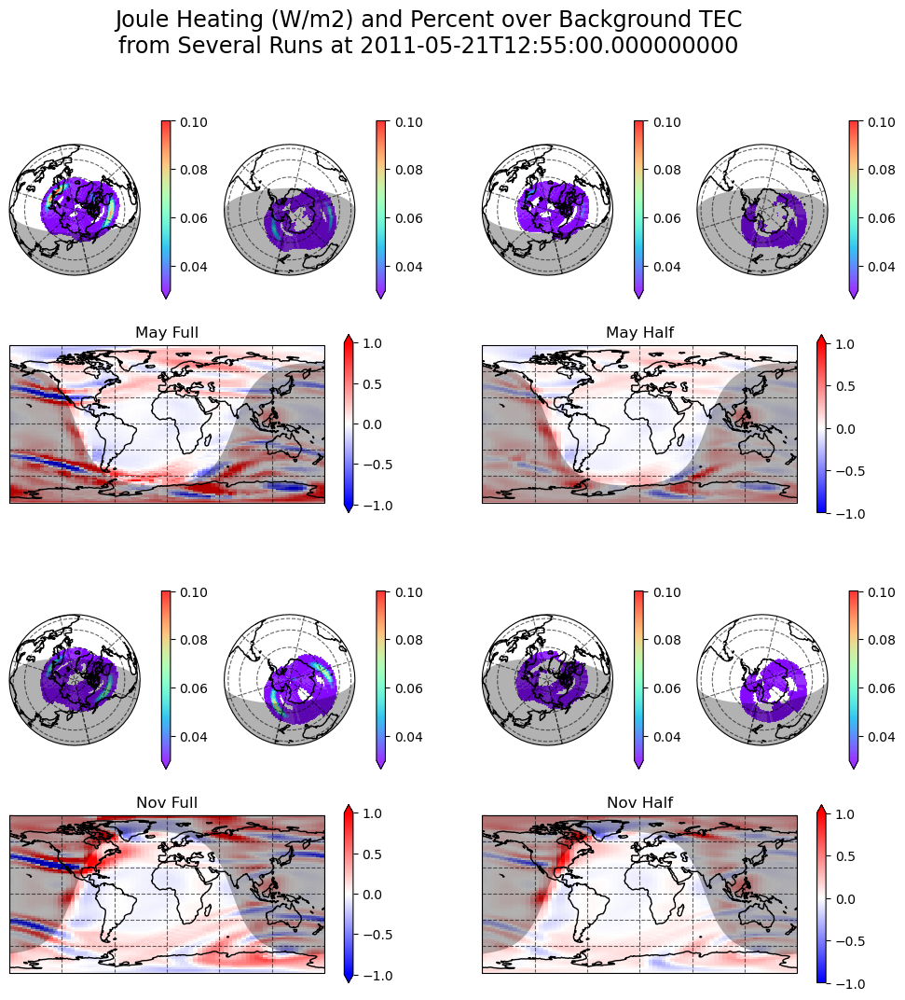

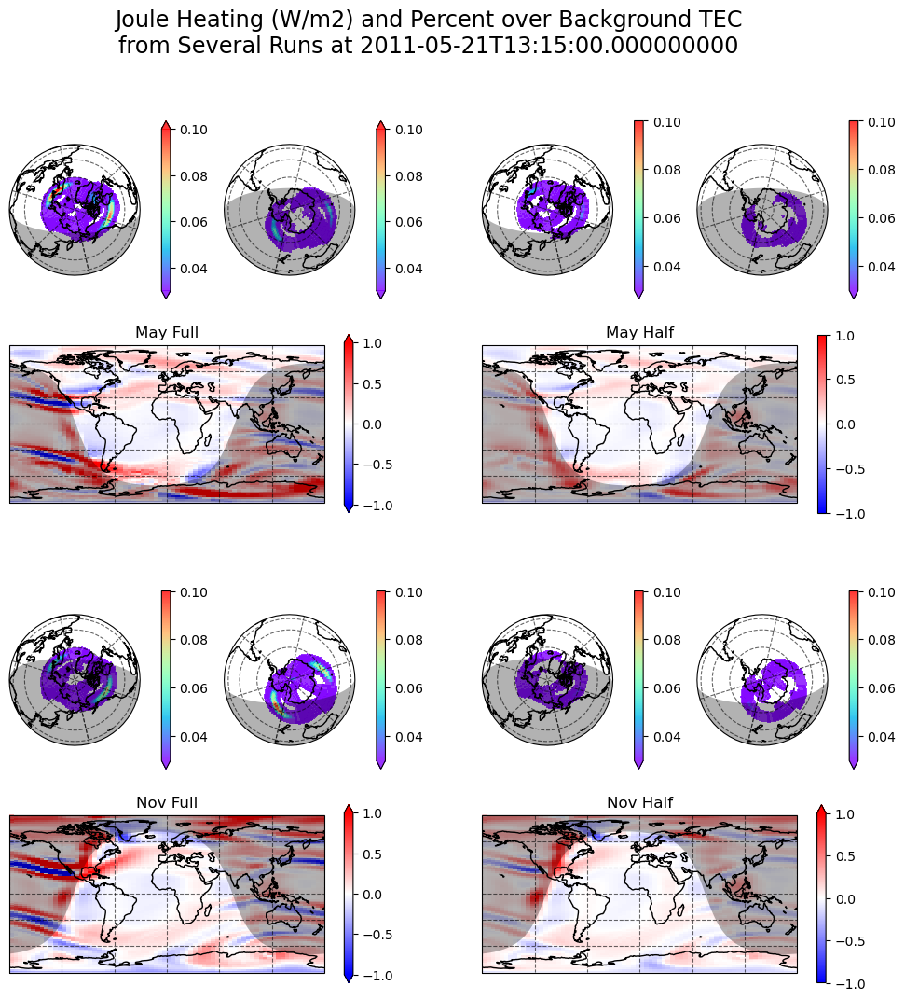

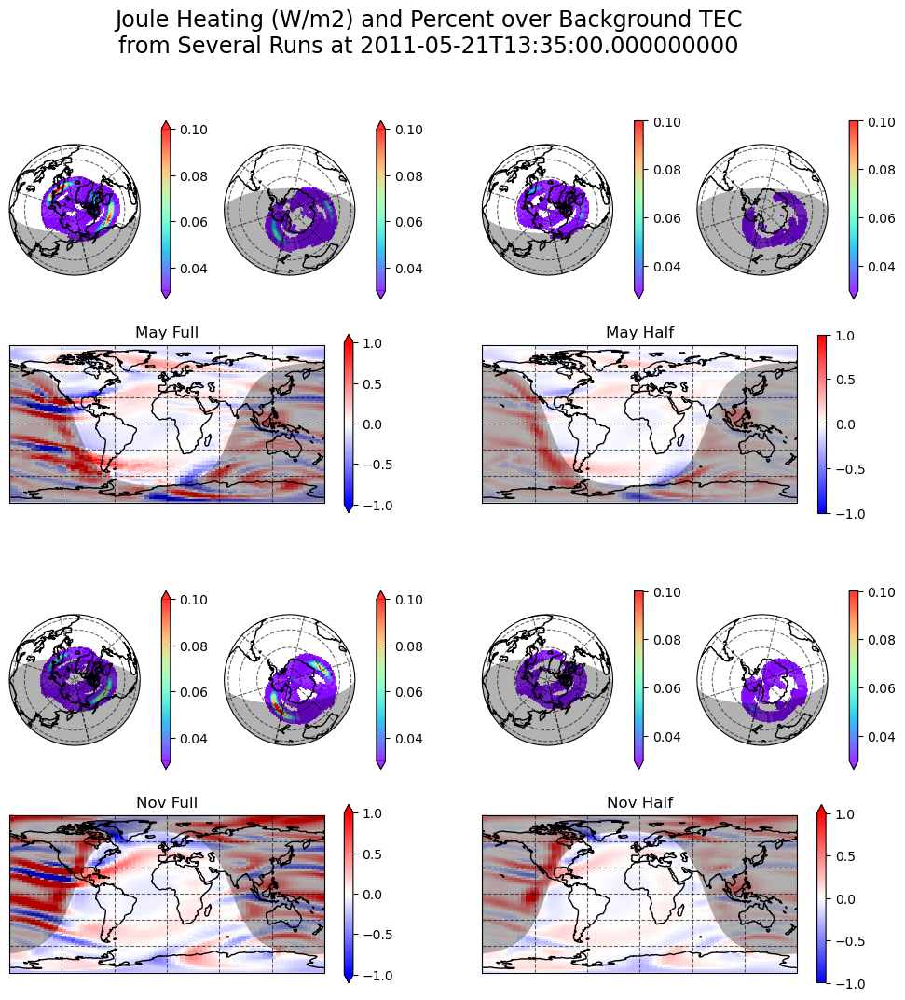

In [69]:
itime = 54
a = 800
times = []

ampkeys = ['may-ut12-storm-on-full', 'may-ut12-storm-on-half',
           'nov-ut12-storm-on-full', 'nov-ut12-storm-on-half']

for itime in [46, 50, 54]:
    map_data = xr.Dataset()
    dial_data = xr.Dataset()

    for k in ampkeys:

        newkey = '-'.join([k.split('-')[0], k.split('-')[-1]])
        dial_data[newkey] = gitms[k].AltIntJouleHeating_W_m2.isel(time=itime)#.reindex_like(gitms['may-full'], fill_value=19)

        map_data[format_colname_for_title(newkey)] = (100*(filters.filter_xarray_DA_diff(
            samis[k].edens.integrate('alt'),
            percent=False,
            label='lower',
            order=2)/samis[k].edens.integrate('alt'))).isel(time=itime).interp({'lat':np.arange(-90,90,.1),
                                              'lon':np.arange(0,360,.25)}, method='linear').coarsen(lat=20, lon=20).mean()
        times.append(samis[k].time.values[itime])



    fig =  plotting_routines.map_and_dials(dial_da=dial_data,
                                            total=4,
                                            map_da=map_data,
                                            max_per_row=2, mask_dials=0.002,

                                            map_cmap='bwr', vmin_dial=0.03, vmax_dial=.10, vmin_map=-1, vmax_map=1,

                                          several_datasets=True, times_datasets=times,
                                           suptitle='Joule Heating (W/m2) and Percent over Background TEC\nfrom Several Runs at %s' %str(map_data.time.values) ,
                                           suptitlesize='xx-large')

    fig.tight_layout()

    fig.show()



# fig.savefig('good-plots/jh-edens-800km_amp-n-season', bbox_inches='tight')



In [92]:
k

'nov-ut12-storm-on-half'

In [162]:
samis[k].edens.integrate('alt').max().compute()*1e-16*1e6, samis[k].edens.integrate('alt').min().compute()*1e-16*1e6

(<xarray.DataArray 'edens' ()>
 array(0.10550656),
 <xarray.DataArray 'edens' ()>
 array(0.00129829))

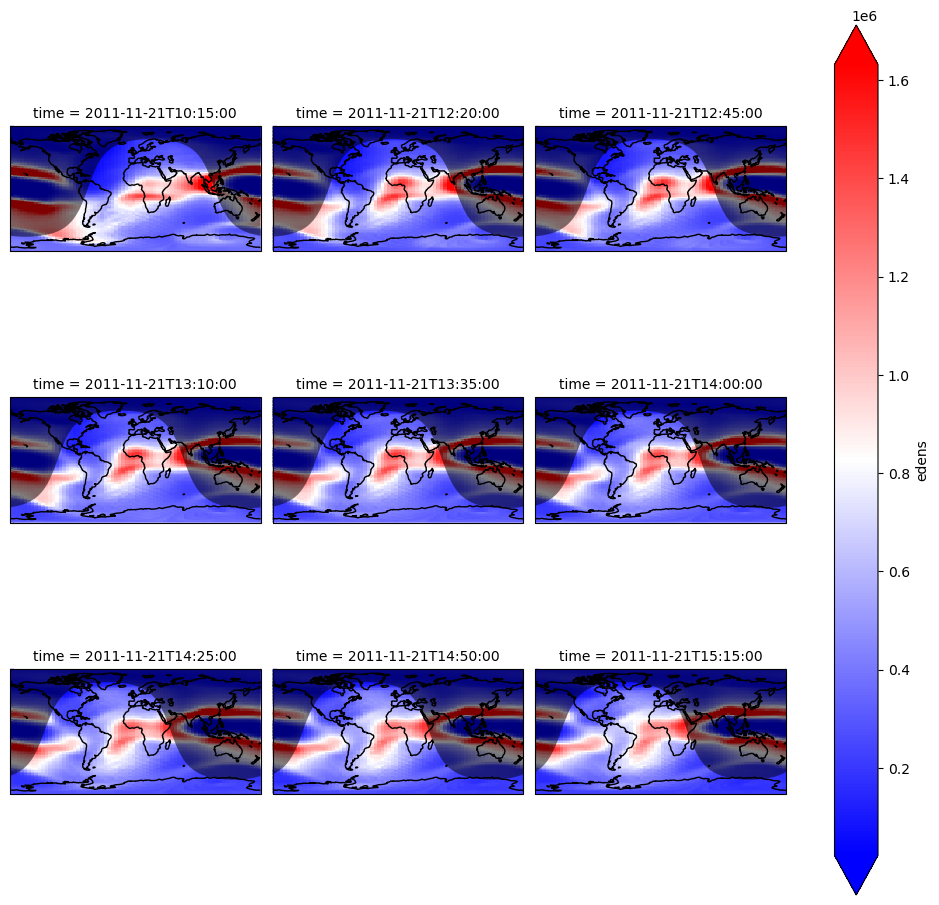

In [8]:
ts = [15, 40, 45, 50, 55, 60, 65, 70, 75]

fig = (samis[k].edens.sel(alt=450, method='nearest')).isel(time=ts).interp({'lat':np.arange(-90,90,.1),
                                              'lon':np.arange(0,360,.25)}, method='linear').coarsen(lat=20,
                                                                                                    lon=20).mean().plot(
    col='time', x='lon', robust=True, cmap='bwr',
    transform=ccrs.PlateCarree(),col_wrap=3,
    subplot_kws={'projection': ccrs.PlateCarree()})

for i, ax in enumerate(fig.axs.flatten()):
    ax.coastlines()
    ax.add_feature(Nightshade(pd.Timestamp(samis[k].time.values[ts[i]])))

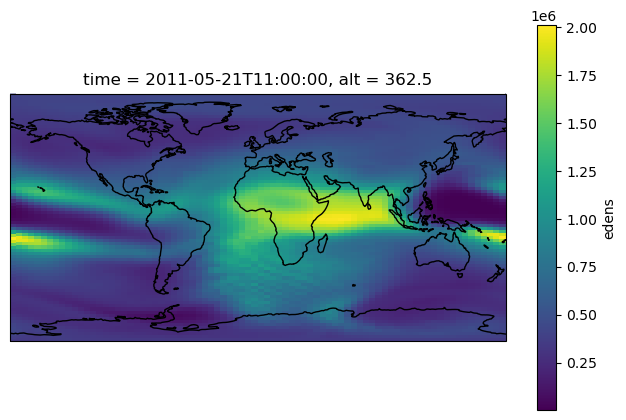

In [35]:
plt.figure(figsize=(8,5))
ax=plt.subplot(projection=ccrs.PlateCarree())
samis['may-ut12-storm-on-half'].sel(alt=350, 
                                    time='2011-05-21 11:00',
                                    method='nearest').edens.interp(
    lat=np.arange(-90,90,.25),
    lon=np.arange(0,360,.5), method='linear').coarsen(lat=9, lon=9).mean().plot(x='lon',
                                                              ax=ax,
                                                              transform=ccrs.PlateCarree(),
                                                              )
ax.coastlines()

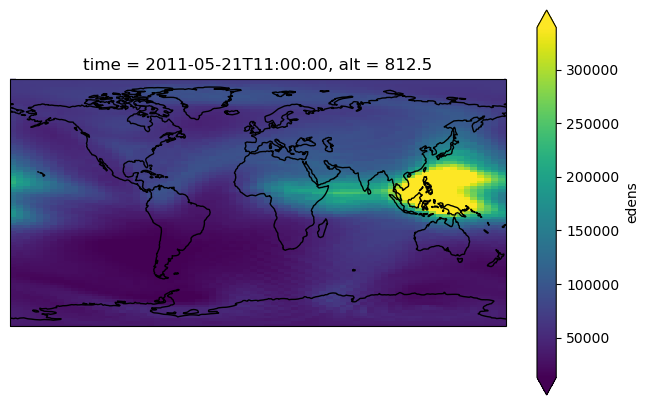

In [32]:
plt.figure(figsize=(8,5))
ax=plt.subplot(projection=ccrs.PlateCarree())

samis['may-ut12-storm-on-half'].sel(alt=800, 
                                    time='2011-05-21 11:00',
                                    method='nearest').edens.plot(x='lon', ax=ax,
                                                                transform=ccrs.PlateCarree(), robust=True)
ax.coastlines()

In [37]:
samis['may-ut12-storm-on-half'].edens.compute()

<xarray.DataArray 'edens' (time: 97, lat: 90, lon: 72, alt: 40)>
array([[[[1.61806604e+05, 3.23904074e+05, 5.00313251e+05, ...,
          2.91428838e+03, 2.57875394e+03, 2.48971117e+03],
         [1.60706321e+05, 3.14302423e+05, 4.99995480e+05, ...,
          2.96740261e+03, 2.58231662e+03, 2.48767405e+03],
         [1.52629277e+05, 3.03315176e+05, 4.99650062e+05, ...,
          2.96949998e+03, 2.60525653e+03, 2.48649279e+03],
         ...,
         [1.71457979e+05, 3.32984481e+05, 5.03067110e+05, ...,
          2.85856692e+03, 2.57005960e+03, 2.42113330e+03],
         [1.67477444e+05, 3.29993402e+05, 5.00893503e+05, ...,
          2.88501523e+03, 2.57262871e+03, 2.42260505e+03],
         [1.64266426e+05, 3.24363482e+05, 5.00610765e+05, ...,
          2.88679225e+03, 2.57552287e+03, 2.46759493e+03]],

        [[1.37753896e+05, 2.74135431e+05, 4.70239745e+05, ...,
          2.34199482e+03, 2.26466278e+03, 1.99454432e+03],
         [1.43266363e+05, 3.62251374e+05, 5.16829770e+05, ...,
          2.42263589e+03, 2.27171970e+03, 2.02159617e+03],
         [1.82013484e+05, 3.63390009e+05, 5.05755437e+05, ...,
          2.42441841e+03, 2.28050773e+03, 2.02964664e+03],
...
         [2.82328250e+05, 3.89488563e+05, 3.86905909e+05, ...,
          3.76153604e+03, 3.50591824e+03, 3.18591115e+03],
         [2.89161729e+05, 3.89613581e+05, 3.84819575e+05, ...,
          3.75288934e+03, 3.46739942e+03, 3.18204923e+03],
         [2.90417139e+05, 3.89697321e+05, 3.83462709e+05, ...,
          3.75277142e+03, 3.46724589e+03, 3.18188764e+03]],

        [[2.59016525e+05, 3.57668587e+05, 3.58247623e+05, ...,
          3.46961672e+03, 3.19959676e+03, 2.93209036e+03],
         [2.59104710e+05, 3.57688063e+05, 3.58206518e+05, ...,
          3.46894676e+03, 3.19853672e+03, 2.93116237e+03],
         [2.59215731e+05, 3.57711512e+05, 3.58153412e+05, ...,
          3.46812044e+03, 3.19719679e+03, 2.93001202e+03],
         ...,
         [2.53049170e+05, 3.57626819e+05, 3.58326170e+05, ...,
          3.47097543e+03, 3.20169219e+03, 2.93396916e+03],
         [2.54012453e+05, 3.57638478e+05, 3.58305531e+05, ...,
          3.47060780e+03, 3.20113152e+03, 2.93346063e+03],
         [2.58945581e+05, 3.57652251e+05, 3.58279882e+05, ...,
          3.47016174e+03, 3.20044518e+03, 2.93284397e+03]]]])
Coordinates:
  * time     (time) datetime64[ns] 2011-05-21T09:00:00 ... 2011-05-21T17:00:00
  * alt      (alt) float64 212.5 262.5 312.5 ... 2.062e+03 2.112e+03 2.162e+03
  * lat      (lat) float64 -89.33 -87.33 -85.33 -83.33 ... 84.67 86.67 88.67
  * lon      (lon) float64 1.667 6.667 11.67 16.67 ... 341.7 346.7 351.7 356.7

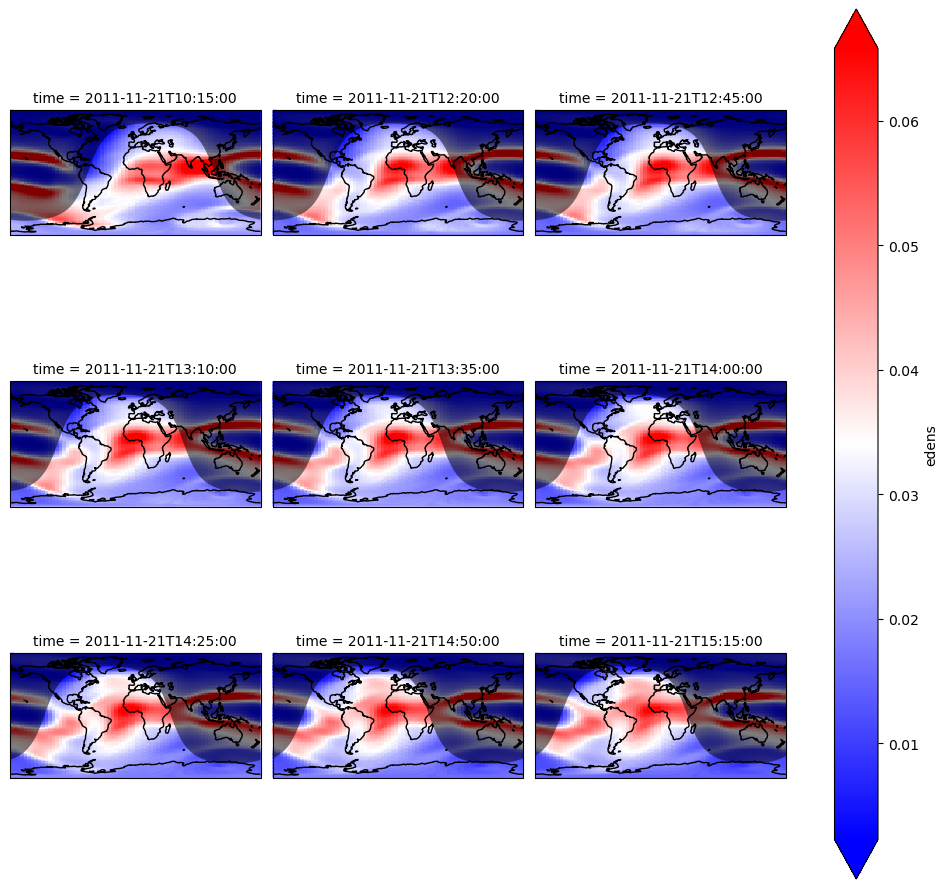

In [174]:
ts = [15, 40, 45, 50, 55, 60, 65, 70, 75]

fig = (samis[k].edens.integrate('alt')*(1e-10)).isel(time=ts).interp({'lat':np.arange(-90,90,.1),
                                              'lon':np.arange(0,360,.25)}, method='linear').coarsen(lat=20,
                                                                                                    lon=20).mean().plot(
    col='time', x='lon', robust=True, cmap='bwr',
    transform=ccrs.PlateCarree(),col_wrap=3,
    subplot_kws={'projection': ccrs.PlateCarree()})

for i, ax in enumerate(fig.axs.flatten()):
    ax.coastlines()
    ax.add_feature(Nightshade(pd.Timestamp(samis[k].time.values[ts[i]])))

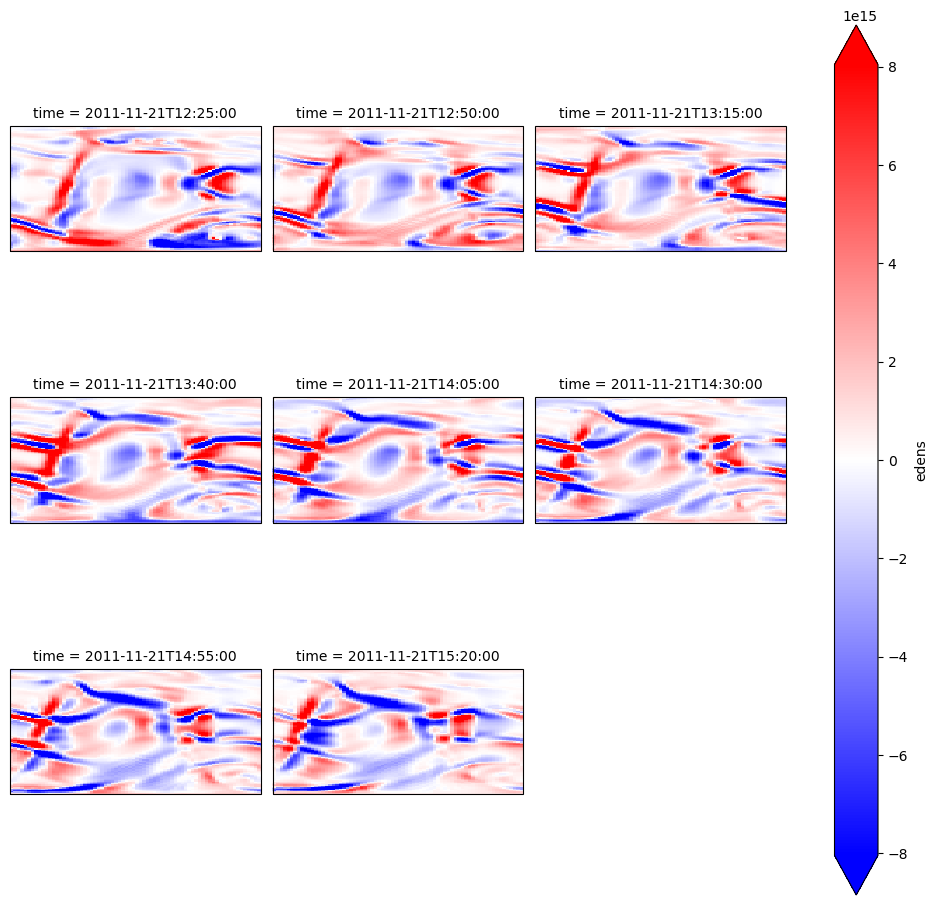

In [154]:
filters.filter_xarray_DA_diff(
            samis[k].edens.integrate('alt')*(1e16*1e-6),
            percent=False,
            label='lower',
            order=2).isel(time=[40, 45, 50, 55, 60, 65, 70, 75]).interp({'lat':np.arange(-90,90,.1),
                                              'lon':np.arange(0,360,.25)}, method='linear').coarsen(lat=20,
                                                                                                    lon=20).mean().plot(
    col='time', x='lon', robust=True, cmap='bwr',
    transform=ccrs.PlateCarree(),col_wrap=3,
    subplot_kws={'projection': ccrs.PlateCarree()})

In [ ]:
filters.filter_xarray_DA_diff(gitms['may-ut12-storm-on-full'].O_3P.sel(lon=300, method='nearest'), percent=True).isel(time=[40, 45, 50, 55, 60, 65, 70, 75]).plot(x='lat', cmap='bwr', col='time', col_wrap=4)

In [47]:

for k in ampkeys:
    print(samis[k].edens.integrate('alt').isel(time=itime).interp({'lat':np.arange(-90,90,2),
                                          'lon':np.arange(0,360,8)}, method='linear').shape)

(90, 45)
(90, 45)
(90, 45)
(90, 45)


In [50]:
samis[k].lon.values

array([  1.66666667,   6.66666667,  11.66666667,  16.66666667,
        21.66666667,  26.66666667,  31.66666667,  36.66666667,
        41.66666667,  46.66666667,  51.66666667,  56.66666667,
        61.66666667,  66.66666667,  71.66666667,  76.66666667,
        81.66666667,  86.66666667,  91.66666667,  96.66666667,
       101.66666667, 106.66666667, 111.66666667, 116.66666667,
       121.66666667, 126.66666667, 131.66666667, 136.66666667,
       141.66666667, 146.66666667, 151.66666667, 156.66666667,
       161.66666667, 166.66666667, 171.66666667, 176.66666667,
       181.66666667, 186.66666667, 191.66666667, 196.66666667,
       201.66666667, 206.66666667, 211.66666667, 216.66666667,
       221.66666667, 226.66666667, 231.66666667, 236.66666667,
       241.66666667, 246.66666667, 251.66666667, 256.66666667,
       261.66666667, 266.66666667, 271.66666667, 276.66666667,
       281.66666667, 286.66666667, 291.66666667, 296.66666667,
       301.66666667, 306.66666667, 311.66666667, 316.66

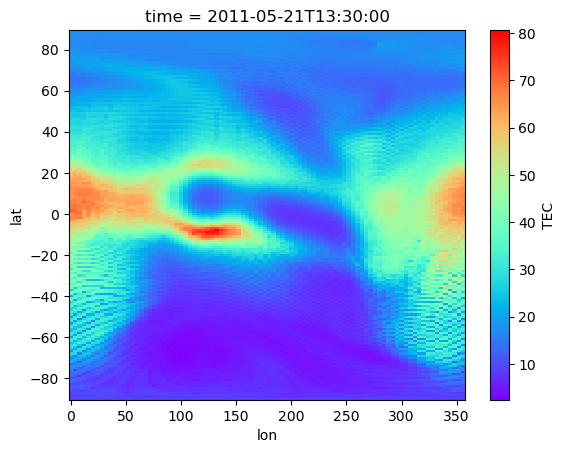

In [39]:
((samis['may-ut12-storm-on-full'].edens.integrate('alt'))*1e6/1e16*1e3).sel(time='2011-05-21 13:30', method='nearest').plot(x='lon',  cbar_kwargs={'label':'TEC'}, cmap='rainbow')

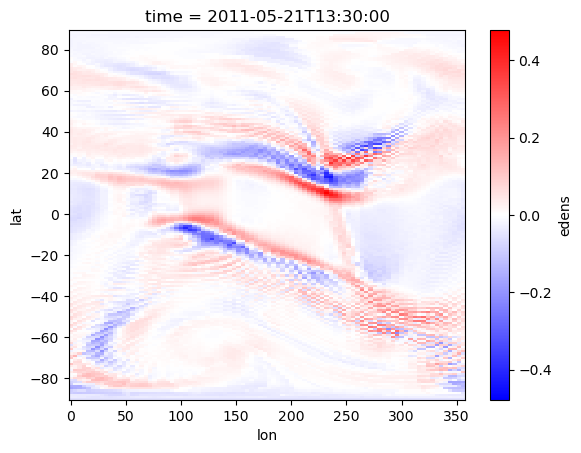

In [41]:
filters.filter_xarray_DA_diff((samis['may-ut12-storm-on-full'].edens.integrate('alt'))*1e6/1e16*1e3).sel(time='2011-05-21 13:30', method='nearest').plot(x='lon', cmap='bwr')

In [51]:
1*1e6/1e16*1e3

1.0000000000000001e-07

In [46]:
axs

array([[<GeoAxes: >, <GeoAxes: >],
       [<GeoAxes: >, <GeoAxes: >]], dtype=object)

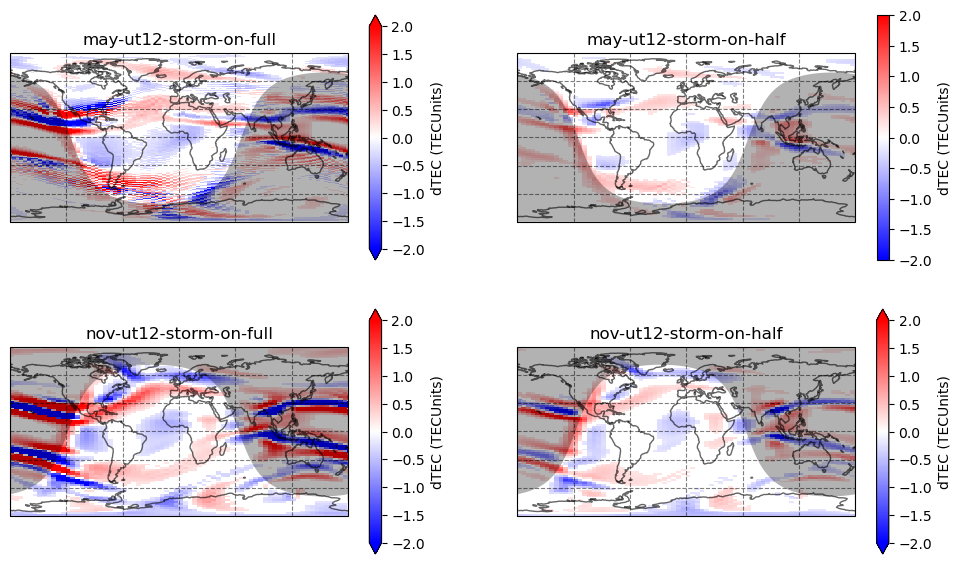

In [55]:
fig, axs = plt.subplots(2, 2,figsize=[12,7], subplot_kw={'projection':ccrs.PlateCarree()})

for i, ax in enumerate(axs.flatten()):
    
    d = filters.filter_xarray_DA_diff(
            samis[ampkeys[i]].edens.integrate('alt'),
            percent=False,
            label='lower',
            order=2)/1e6
    d.where(np.abs(d) > .2).isel(time=itime).plot(ax=ax, 
                                                  vmin=-2, vmax=2, 
                                                  transform=ccrs.PlateCarree(),
                                                  cmap='bwr', cbar_kwargs={'label':'dTEC (TECUnits)'})
    ax.set_title(ampkeys[i])
    ax.coastlines(alpha=0.6)
    ax.gridlines(color='black', alpha=0.5, linestyle='--')
    ax.add_feature(Nightshade(pd.Timestamp(d.isel(time=itime).time.values)), alpha=0.3)
fig.show()

In [95]:
samis['may-ut18-storm-on-full'].data_vars

Data variables:
    edens           (time, lat, lon, alt) float64 dask.array<chunksize=(97, 90, 72, 40), meta=np.ndarray>
    h+dens          (time, lat, lon, alt) float64 dask.array<chunksize=(97, 90, 72, 40), meta=np.ndarray>
    o+dens          (time, lat, lon, alt) float64 dask.array<chunksize=(97, 90, 72, 40), meta=np.ndarray>
    n+odens         (time, lat, lon, alt) float64 dask.array<chunksize=(97, 90, 72, 40), meta=np.ndarray>
    o2+dens         (time, lat, lon, alt) float64 dask.array<chunksize=(97, 90, 72, 40), meta=np.ndarray>
    he+dens         (time, lat, lon, alt) float64 dask.array<chunksize=(97, 90, 72, 40), meta=np.ndarray>
    n2+dens         (time, lat, lon, alt) float64 dask.array<chunksize=(97, 90, 72, 40), meta=np.ndarray>
    n+dens          (time, lat, lon, alt) float64 dask.array<chunksize=(97, 90, 72, 40), meta=np.ndarray>
    hdens           (time, lat, lon, alt) float64 dask.array<chunksize=(97, 90, 72, 40), meta=np.ndarray>
    odens           (time, lat

In [127]:
gitms.keys()

dict_keys(['may-ut12-storm-1hr-full', 'may-ut12-storm-on-full', 'may-ut18-storm-on-full', 'may-ut6-storm-1hr-full', 'may-ut6-storm-on-full', 'may-ut12-storm-1hr-half', 'may-ut12-storm-on-half', 'may-ut12-storm-on-quarter', 'nov-ut12-storm-on-full', 'nov-ut18-storm-on-full', 'nov-ut6-storm-on-full', 'nov-ut12-storm-on-half', 'nov-ut12-storm-on-bz15-byneg', 'nov-ut12-storm-on-bz15-bypos', 'nov-ut12-storm-on-bz17', 'nov-ut12-storm-on-bz8-byneg', 'nov-ut12-storm-on-bz8-bypos'])

In [79]:
samis.keys()

dict_keys(['may-ut12-storm-on-full', 'may-ut18-storm-on-full', 'may-ut6-storm-on-full', 'may-ut12-storm-on-half', 'may-ut12-storm-on-quarter', 'nov-ut12-storm-on-full', 'nov-ut18-storm-on-full', 'nov-ut6-storm-on-full', 'nov-ut12-storm-on-half', 'nov-ut12-storm-on-bz15-byneg', 'nov-ut12-storm-on-bz15-bypos', 'nov-ut12-storm-on-bz17', 'nov-ut12-storm-on-bz8-byneg', 'nov-ut12-storm-on-bz8-bypos'])

In [39]:
utkeys = [['may-ut12-storm-on-full', 'may-ut18-storm-on-full', 'may-ut6-storm-on-full'],
         ['nov-ut12-storm-on-full', 'nov-ut18-storm-on-full', 'nov-ut6-storm-on-full']]

In [40]:
lts_to_keo = [6,12,18,23.9]

In [41]:
from utility_programs import utils

In [42]:
utils = importlib.reload(utils)

In [43]:
utkeys

[['may-ut12-storm-on-full', 'may-ut18-storm-on-full', 'may-ut6-storm-on-full'],
 ['nov-ut12-storm-on-full', 'nov-ut18-storm-on-full', 'nov-ut6-storm-on-full']]

In [56]:
b = samis[run].edens.sel(alt=350, method='nearest')
b = utils.add_lt_to_dataset(filters.filter_xarray_DA_diff(b), 40)

In [57]:
b

<xarray.DataArray 'edens' (localtime: 40, time: 95, lat: 180)>
dask.array<concatenate, shape=(40, 95, 180), dtype=float64, chunksize=(1, 1, 180), chunktype=numpy.ndarray>
Coordinates:
    alt        float64 350.0
  * lat        (lat) float64 -90.0 -89.0 -88.0 -87.0 ... 86.0 87.0 88.0 89.0
    lon        (localtime, time) float64 224.0 224.0 224.0 ... 92.0 88.0 88.0
  * localtime  (localtime) float64 0.0 0.5854 1.171 1.756 ... 21.66 22.24 22.83
  * time       (time) datetime64[ns] 2011-05-21T09:05:00 ... 2011-05-21T16:55:00

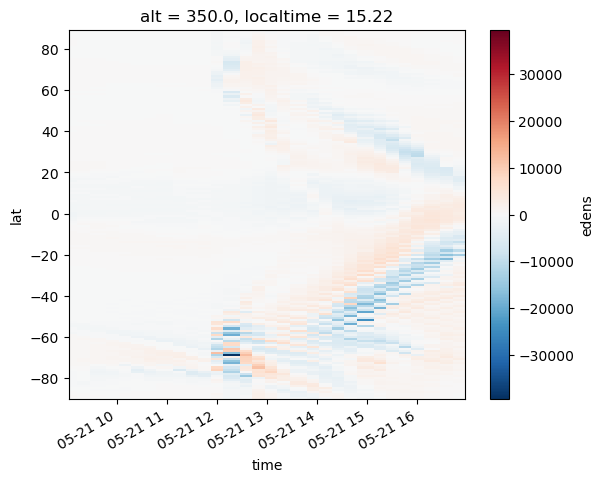

In [59]:
b.sel(localtime=15, method='nearest').plot(x='time')

/glade/scratch/abukowski/ipykernel_54587/905082547.py:1: UserWarning: Converting non-nanosecond precision datetime values to nanosecond precision. This behavior can eventually be relaxed in xarray, as it is an artifact from pandas which is now beginning to support non-nanosecond precision values. This warning is caused by passing non-nanosecond np.datetime64 or np.timedelta64 values to the DataArray or Variable constructor; it can be silenced by converting the values to nanosecond precision ahead of time.
  b.sel(localtime=15, method='nearest').interp(lat=np.arange(-90,90,.25),time=np.arange(pd.Timestamp(b.time.min().values),


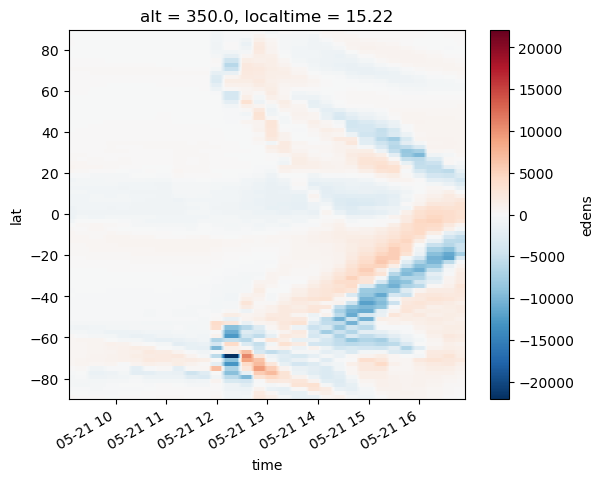

In [67]:
b.sel(localtime=15, method='nearest').interp(lat=np.arange(-90,90,.25),time=np.arange(pd.Timestamp(b.time.min().values),
                                                                            pd.Timestamp(b.time.max().values),
                                                                            pd.Timedelta('1 minute'))).coarsen(lat=8).mean().plot(x='time')

In [73]:
for mn in utkeys:
    # fig, axs = plt.subplots(3,1, figsize=(10,10))
    for i, run in enumerate(mn):
        fig = utils.add_lt_to_dataset(filters.filter_xarray_DA_diff(
            samis[run].edens.sel(alt=350, method='nearest')),
                                      localtimes = 60).sel(localtime=lts_to_keo,
                                                           method='nearest').plot(col='localtime',
                                                                       col_wrap = 4,
                                                                       x='time',
                                                                       vmin=-.5, vmax=.5,
                                                                       cmap='bwr',
                                                                       add_colorbar=False)
        
        divider = make_axes_locatable(plt.gca())
        cax = divider.append_axes("right", "5%", pad="3%")
        fig.add_colorbar(cax=cax)
        fig.fig.suptitle(run, fontsize='x-large')
        fig.fig.set_layout_engine('tight', )
        plt.show()
    break
        # plt.savefig('FinalDraftPlots/1hrvson/no_subtract/keo-'+run, bbox_inches='tight')#show()
    # break

KeyboardInterrupt: 

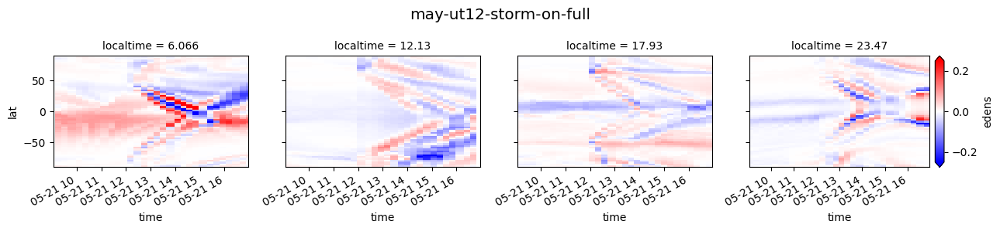

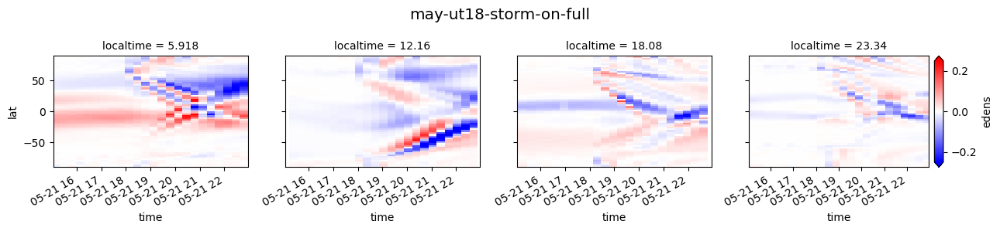

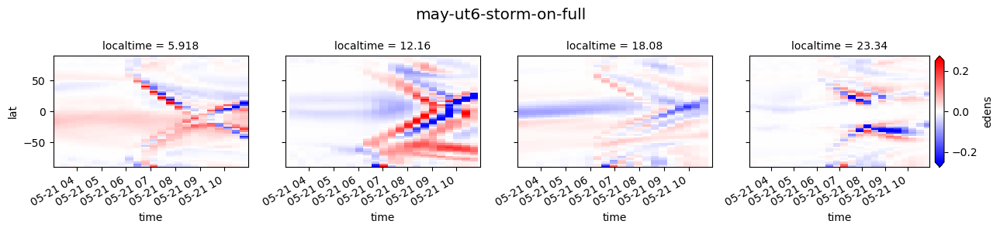

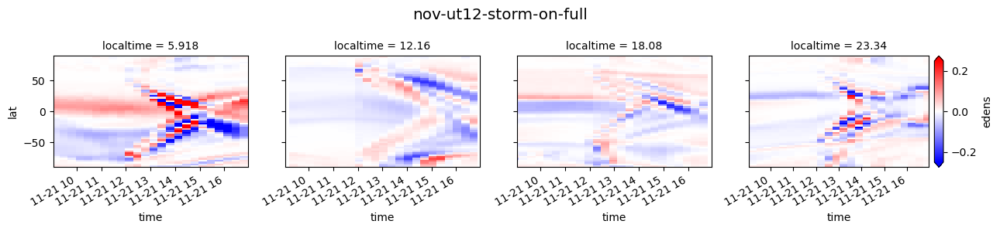

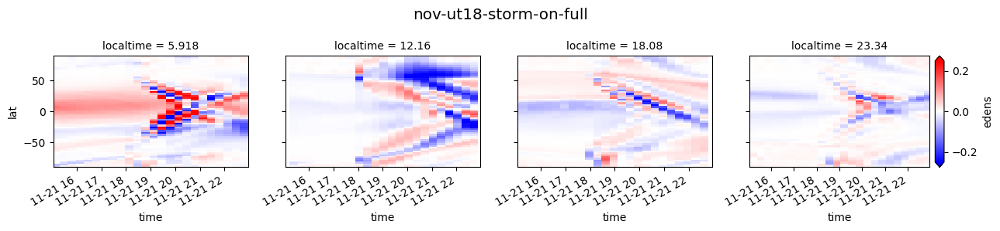

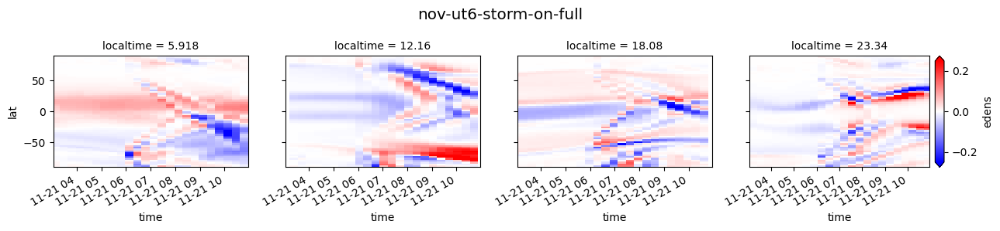

In [79]:
for mn in utkeys:
    # fig, axs = plt.subplots(3,1, figsize=(10,10))
    for i, run in enumerate(mn):
        fig = utils.add_lt_to_dataset(filters.filter_xarray_DA_diff(
            (samis[run].edens.integrate('alt')*1e6/1e16*1e3))).sel(localtime=lts_to_keo,
                                                           
                                                           method='nearest').interp(lat=np.arange(-90,90,0.25)
                                                                                   ).coarsen(lat=12, boundary='pad').mean(
        ).plot(col='localtime',
                                                                       col_wrap = 4,
                                                                       x='time',
                                                                       vmin=-.25, vmax=.25,
                                                                       cmap='bwr',
                                                                       add_colorbar=False,)
        
        divider = make_axes_locatable(plt.gca())
        cax = divider.append_axes("right", "5%", pad="3%")
        fig.add_colorbar(cax=cax, )
        fig.fig.suptitle(run, fontsize='x-large')
        fig.fig.set_layout_engine('tight', )
        plt.savefig('FinalDraftPlots/SAMI3TEC-UTdiffs' + run)
    #     break
    # break

In [150]:
for run in gitms.keys():
    
    if 'hr' in run and run.replace('1hr', 'on') in gitms.keys():
        print(run)

may-ut12-storm-1hr-full
may-ut6-storm-1hr-full
may-ut12-storm-1hr-half


In [ ]:
with tqdm(total=21*3) as pbar:

    for run in gitms.keys():

        if 'hr' in run and run.replace('1hr', 'on') in gitms.keys():
            for alt_now in [250, 400, 600]:
                for col in ['Rho','e_','Temperature','iTemperature','eTemperature','Vn_east','Vn_north']:
                    fig = utils.add_lt_to_dataset(filters.filter_xarray_DA_diff(
                        gitms[run][col].sel(alt=alt_now, method='nearest'))
                                      ,localtimes = 90).sel(localtime=lts_to_keo,
                                                            method='nearest').plot(col='localtime',
                                                                                   col_wrap = 4,
                                                                                   x='time', robust=True,
                                                                                   cmap='bwr', add_colorbar=False)

                    divider = make_axes_locatable(plt.gca())
                    cax = divider.append_axes("right", "5%", pad="3%")
                    fig.add_colorbar(cax=cax)
                    fig.fig.suptitle(run +' at alt=%i km' %alt_now, fontsize='x-large')
                    fig.fig.set_layout_engine('tight', )
                    plt.savefig('good-plots/gitm-keos-1hrvson/gitm-keos1-'+run+'-'+str(alt_now)+'-'+str(col), bbox_inches='tight')

                    run2 = run.replace('1hr', 'on')
                    fig = utils.add_lt_to_dataset(filters.filter_xarray_DA_diff(
                        gitms[run2][col].sel(alt=alt_now, method='nearest'))
                                      ,localtimes = 90).sel(localtime=lts_to_keo,
                                                            method='nearest').plot(col='localtime',
                                                                                   col_wrap = 4,
                                                                                   x='time', robust=True,
                                                                                   cmap='bwr', add_colorbar=False)

                    divider = make_axes_locatable(plt.gca())
                    cax = divider.append_axes("right", "5%", pad="3%")
                    fig.add_colorbar(cax=cax)
                    fig.fig.suptitle(run2 +' at alt=%i km' %alt_now, fontsize='x-large')
                    fig.fig.set_layout_engine('tight', )
                    plt.savefig('good-plots/gitm-keos-1hrvson/gitm-keos2-'+run2+'-'+str(alt_now)+'-'+str(alt_now), bbox_inches='tight')
                    pbar.update()

 16%|█▌        | 10/63 [30:25<2:40:23, 181.57s/it]/glade/work/abukowski/conda-envs/SAMI3-GITM/lib/python3.10/site-packages/xarray/plot/facetgrid.py:218: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axs = plt.subplots(
 97%|█████████▋| 61/63 [3:08:13<06:13, 186.58s/it]  

In [ ]:
for run in gitms.keys():
    
    if 'hr' in run and run.replace('1hr', 'on') in gitms.keys():
        for alt_now in [250, 400, 600]:
            fig = utils.add_lt_to_dataset(filters.filter_xarray_DA_diff(
                samis[run].edens.sel(alt=alt_now, method='nearest'))
                              ,localtimes = 90).sel(localtime=lts_to_keo,
                                                    method='nearest').plot(col='localtime',
                                                                           col_wrap = 4,
                                                                           x='time', robust=True,
                                                                           cmap='bwr', add_colorbar=False)

            divider = make_axes_locatable(plt.gca())
            cax = divider.append_axes("right", "5%", pad="3%")
            fig.add_colorbar(cax=cax)
            fig.fig.suptitle(run +' at alt=%i km' %alt_now, fontsize='x-large')
            fig.fig.set_layout_engine('tight', )
            plt.savefig('good-plots/sami-keos1-'+run+'-'+str(alt_now), bbox_inches='tight')

            run = run.replace('1hr', 'on')
            fig = utils.add_lt_to_dataset(filters.filter_xarray_DA_diff(
                gitms[run].Rho.sel(alt=alt_now, method='nearest'))
                              ,localtimes = 90).sel(localtime=lts_to_keo,
                                                    method='nearest').plot(col='localtime',
                                                                           col_wrap = 4,
                                                                           x='time', robust=True,
                                                                           cmap='bwr', add_colorbar=False)

            divider = make_axes_locatable(plt.gca())
            cax = divider.append_axes("right", "5%", pad="3%")
            fig.add_colorbar(cax=cax)
            fig.fig.suptitle(run +' at alt=%i km' %alt_now, fontsize='x-large')
            fig.fig.set_layout_engine('tight', )
            plt.savefig('good-plots/sami-keos2-'+run+'-'+str(alt_now), bbox_inches='tight')

In [ ]:
good-plots/

In [130]:
gitms.keys()

dict_keys(['may-ut12-storm-1hr-full', 'may-ut12-storm-on-full', 'may-ut18-storm-on-full', 'may-ut6-storm-1hr-full', 'may-ut6-storm-on-full', 'may-ut12-storm-1hr-half', 'may-ut12-storm-on-half', 'may-ut12-storm-on-quarter', 'nov-ut12-storm-on-full', 'nov-ut18-storm-on-full', 'nov-ut6-storm-on-full', 'nov-ut12-storm-on-half', 'nov-ut12-storm-on-bz15-byneg', 'nov-ut12-storm-on-bz15-bypos', 'nov-ut12-storm-on-bz17', 'nov-ut12-storm-on-bz8-byneg', 'nov-ut12-storm-on-bz8-bypos'])

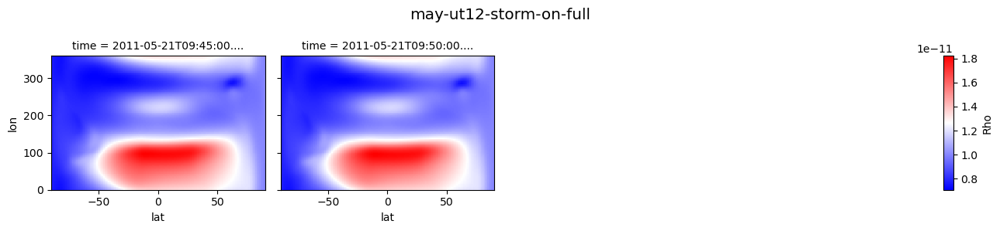

KeyboardInterrupt: 

In [124]:
for mn in utkeys:
    # fig, axs = plt.subplots(3,1, figsize=(10,10))
    for i, run in enumerate(mn):
        fig = gitms[run].Rho.sel(alt=350, method='nearest').isel(
                          time = [9, 10]).plot(col='time',
                                                                       col_wrap = 4,
                                                                       x='lat', 
                                                                       cmap='bwr', add_colorbar=False)
        
        divider = make_axes_locatable(plt.gca())
        cax = divider.append_axes("right", "5%", pad="3%")
        fig.add_colorbar(cax=cax)
        fig.fig.suptitle(run, fontsize='x-large')
        fig.fig.set_layout_engine('tight', )
        plt.show()
    break

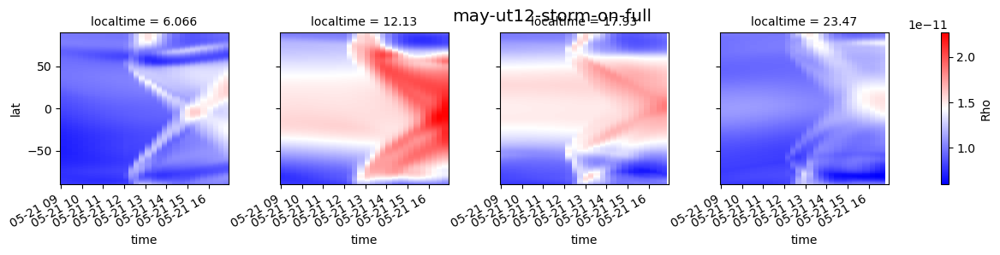

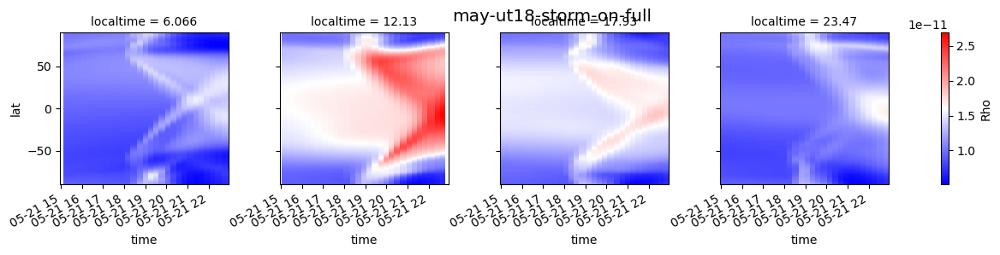

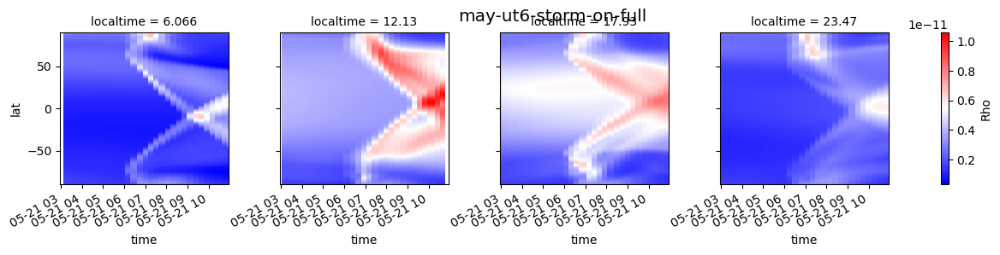

In [99]:
for mn in utkeys:
    # fig, axs = plt.subplots(3,1, figsize=(10,10))
    for i, run in enumerate(mn):
        fig = utils.add_lt_to_dataset(
            gitms[run].Rho.sel(alt=350, method='nearest')
                          ,localtimes = 90).sel(localtime=lts_to_keo,
                                                method='nearest').plot(col='localtime',
                                                                       col_wrap = 4,
                                                                       x='time', 
                                                                       cmap='bwr')
        
        fig.fig.suptitle(run, fontsize='x-large')
        fig.fig.tight_layout()
        plt.show()
    break